# Machine Learning Project - Consumer Complaints

## The data

In [144]:
import numpy as np
import pandas as pd
import glob
import matplotlib.pyplot as plt
import seaborn as sns

csv_files = 'data/complaints-2020-01-22_08_24/*.csv'
dataset = pd.concat([pd.read_csv(f, header=0, delim_whitespace=False) for f in glob.glob(csv_files)], ignore_index = True)
dataset.head()

,Unnamed: 0,Date received,Product,Sub-product,Issue,Sub-issue,Consumer complaint narrative,Company public response,Company,State,ZIP code,Tags,Consumer consent provided?,Submitted via,Date sent to company,Company response to consumer,Timely response?,Consumer disputed?,Complaint ID
0,250000,02/17/17,Mortgage,Conventional fixed mortgage,"Loan servicing, payments, escrow account",None,My husband XXXX XXXX passed away on XXXX/XXXX/...,Company has responded to the consumer and the ...,WELLS FARGO & COMPANY,TX,750XX,Older American,Consent provided,Web,02/17/17,Closed with explanation,Yes,No,2350810
1,250001,03/31/17,Mortgage,Conventional fixed mortgage,"Loan servicing, payments, escrow account",None,Extortion excess escrow ; with threatened Fore...,Company believes it acted appropriately as aut...,Ditech Financial LLC,MI,48072,None,Consent provided,Web,03/31/17,Closed with explanation,Yes,Yes,2413884
2,250002,04/07/17,Debt collection,"Other (i.e. phone, health club, etc.)",Improper contact or sharing of info,Talked to a third party about my debt,I do not have a contract with Diversified Cons...,None,"Diversified Consultants, Inc.",MO,631XX,None,Consent provided,Web,04/07/17,Closed with explanation,Yes,No,2424349
3,250003,03/24/17,Consumer Loan,Title loan,Payment to acct not credited,None,"A 20 year loan at .0875 simple interest, in XX...",None,PNC Bank N.A.,FL,327XX,None,Consent provided,Web,03/24/17,Closed with explanation,Yes,No,2402336
4,250004,08/05/15,Debt collection,I do not know,Cont'd attempts collect debt not owed,Debt is not mine,"I continue to get calls from this company, I b...",None,High Point Asset Inc,DE,199XX,Older American,Consent provided,Web,09/21/15,Closed with explanation,No,No,1503579


Initial data cleaning.

In [145]:
import re

# drop columns that aren't going to be used
cleaned_dataset = dataset.drop(['Unnamed: 0', 'Date received', 'Company', 'State', 'ZIP code', 'Tags', 'Consumer consent provided?', 'Submitted via', 'Company response to consumer', 'Timely response?', 'Date sent to company', 'Consumer disputed?', 'Complaint ID'], axis=1)
# remove useless text parts
cleaned_dataset['Consumer complaint narrative'] = cleaned_dataset['Consumer complaint narrative'].replace(to_replace='xx/xx/\d{4}|XX/XX/\d{4}|\d\d/\d\d/\d{4}|xx/xx/\d{2}|XX/XX/\d{2}|\d\d/\d\d/\d{2}|xx+|XX+|{|}|\$\d+(\.\d+)?', value='', regex=True)
# replace consecutive spaces by only one space
cleaned_dataset['Consumer complaint narrative'] = cleaned_dataset['Consumer complaint narrative'].replace(to_replace='\s\s+', value=' ', regex=True)

In [146]:
cols = ['Product', 'Sub-product', 'Issue', 'Sub-issue']
ids = []
label_to_id = []
id_to_label = []

count = 0
for c in cols:
    one_hot_encoding = pd.get_dummies(cleaned_dataset[c], prefix = c)
    cleaned_dataset = pd.concat([cleaned_dataset, one_hot_encoding], axis = 1)
    
    cleaned_dataset[c + ' id'] = cleaned_dataset[c].factorize()[0]
    ids.append(cleaned_dataset[[c, c + ' id']].drop_duplicates().sort_values(c + ' id'))
    label_to_id.append(dict(ids[count].values))
    id_to_label.append(dict(ids[count][[c + ' id', c]].values))
    count += 1

In [1]:
import nltk
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')

[nltk_data] Downloading package stopwords to
[nltk_data]     /home/gwerrebr/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /home/gwerrebr/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /home/gwerrebr/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

Data cleaning by removing symbols, short words, stopwords and by stemming words to their dictionary form by using a lemmatizer.

In [2]:
import re
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
stop_words = set(stopwords.words('english'))
lemma = WordNetLemmatizer()

def clean_col(col):
    cleaned_col = []
    for r in range(0,len(col)):
        row = str(col[r])
        row = row.lower()
        row = re.sub('[^a-zA-Z]',' ', row)
        row = re.sub(r'\b\w{1}\b', '', row)

        word_tokens = word_tokenize(row)
        
        row = [w for w in word_tokens if w not in stop_words]
        row = ' '.join(row)
        row = [lemma.lemmatize(w) for w in word_tokenize(str(row).lower())]
        row = ' '.join(row)
        cleaned_col.append(row)
    return cleaned_col

In [149]:
%%time

cleaned_dataset['Consumer complaint narrative'] = clean_col(cleaned_dataset['Consumer complaint narrative'])

CPU times: user 23min 22s, sys: 2.29 s, total: 23min 24s
Wall time: 23min 24s


In [7]:
show_n_rows = 50

pd.set_option('display.max_colwidth', None)
pd.options.display.max_rows = show_n_rows

cleaned_dataset['Consumer complaint narrative'].head(show_n_rows)

0                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                       

Train a Doc2Vec model.

In [8]:
from gensim.models.doc2vec import Doc2Vec, TaggedDocument
from nltk.tokenize import word_tokenize

X = cleaned_dataset['Consumer complaint narrative']
Y = [[i] for i in range(len(X))]
tagged_data  = [TaggedDocument(X[i], Y[i]) for i in range(len(X))]


model = Doc2Vec(
    vector_size=300, 
    alpha=0.025, 
    min_alpha=0.00025, 
    min_count=2, 
    sample=0.00001, 
#     window=25, 
#     negative=5, 
    dm=1
)

model.build_vocab(tagged_data)
model.train(tagged_data, total_examples=model.corpus_count, epochs=model.epochs)


filename = "doc2vec_model"
model.save(filename)
print("Model Saved (" + filename + ")")

Model Saved (doc2vec_model)


Vectorize the whole dataset with the trained model.

In [9]:
from gensim.models.doc2vec import Doc2Vec

fname = "doc2vec_model"
model = Doc2Vec.load(fname)
X = cleaned_dataset['Consumer complaint narrative']

vectorized_complaints = []
for x in X[:]:
    vectorized_complaints.append(model.infer_vector(list(x)))

Perform PCA on the vectorized dataset for outlier detection.

In [10]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2).fit(vectorized_complaints)
pca_vectorized_complaints = pca.transform(vectorized_complaints)

Perform SVD on the vectorized dataset for outlier detection.

In [11]:
from sklearn.decomposition import TruncatedSVD

svd = TruncatedSVD(n_components=2)
svd_vectorized_complaints = svd.fit_transform(vectorized_complaints)

Function to detect outliers with 4 different algorithms.

In [12]:
import time

import matplotlib
import matplotlib.pyplot as plt
matplotlib.rcParams['contour.negative_linestyle'] = 'solid'

from sklearn import svm
from sklearn.covariance import EllipticEnvelope
from sklearn.ensemble import IsolationForest
from sklearn.neighbors import LocalOutlierFactor

def compute_and_plot_outliers(data, outliers_fraction=0.01):
    anomaly_algorithms = [
        ("Robust covariance", EllipticEnvelope(contamination=outliers_fraction)),
        ("One-Class SVM", svm.OneClassSVM(nu=outliers_fraction, kernel="rbf", gamma=0.1)),
        ("Isolation Forest", IsolationForest(contamination=outliers_fraction)),
        ("Local Outlier Factor", LocalOutlierFactor(n_neighbors=35, contamination=outliers_fraction))
    ]

    xx, yy = np.meshgrid(np.linspace(-1, 1, 150), np.linspace(-1, 1, 150))

    y_preds = []
    
    for name, algorithm in anomaly_algorithms:
        t0 = time.time()

        algorithm.fit(data)

        plt.figure(figsize=(10, 10))
        plt.title("Outlier detection with " + name, size=18)

        if name == "Local Outlier Factor":
            y_pred = algorithm.fit_predict(data)
        else:
            y_pred = algorithm.fit(data).predict(data)
        
        y_preds.append(y_pred)

        if name != "Local Outlier Factor":
            Z = algorithm.predict(np.c_[xx.ravel(), yy.ravel()])
            Z = Z.reshape(xx.shape)
            plt.contour(xx, yy, Z, levels=[0], linewidths=2, colors='black')

        t1 = time.time()

        colors = np.array(['#377eb8', '#ff7f00'])
        plt.scatter(data[:, 0], data[:, 1], s=10, color=colors[(y_pred + 1) // 2])

        plt.xlim(-1, 1)
        plt.ylim(-1, 1)
        plt.xticks(())
        plt.yticks(())
        plt.text(.99, .01, ('%.2fs' % (t1 - t0)).lstrip('0'), transform=plt.gca().transAxes, size=15, horizontalalignment='right')
        
        plt.show()
    
    return y_preds

Detect outliers both by using PCA and SVD.

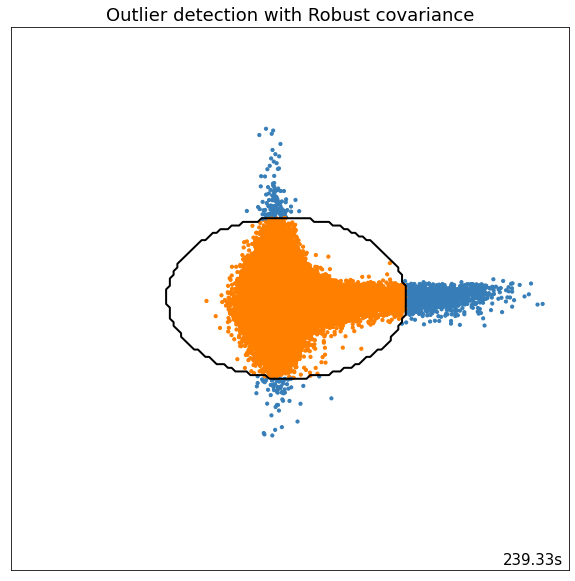

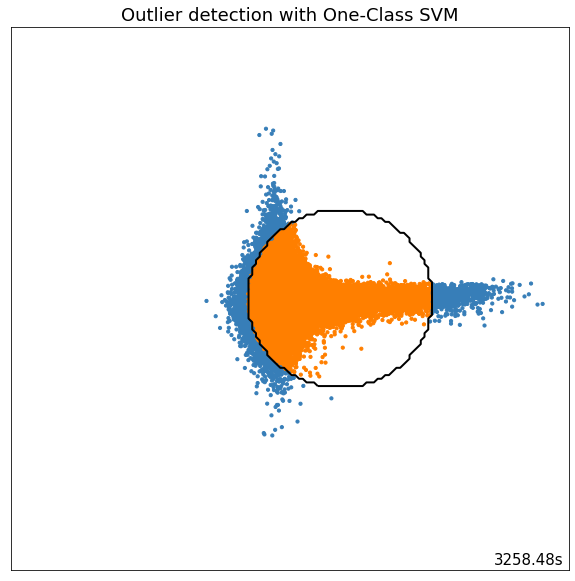

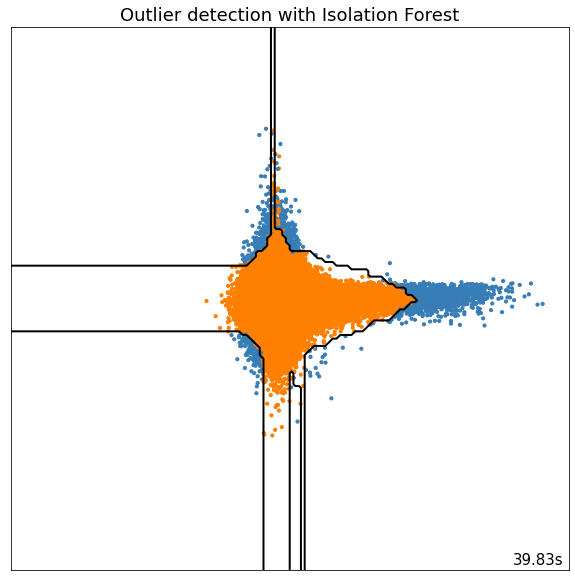

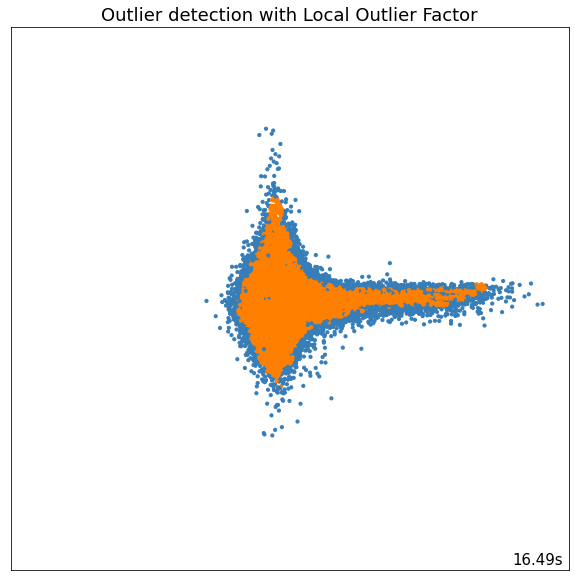

In [13]:
pca_y_preds = compute_and_plot_outliers(pca_vectorized_complaints)

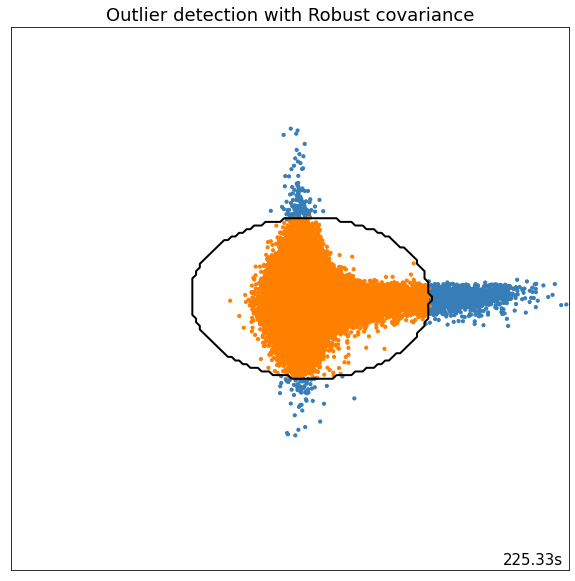

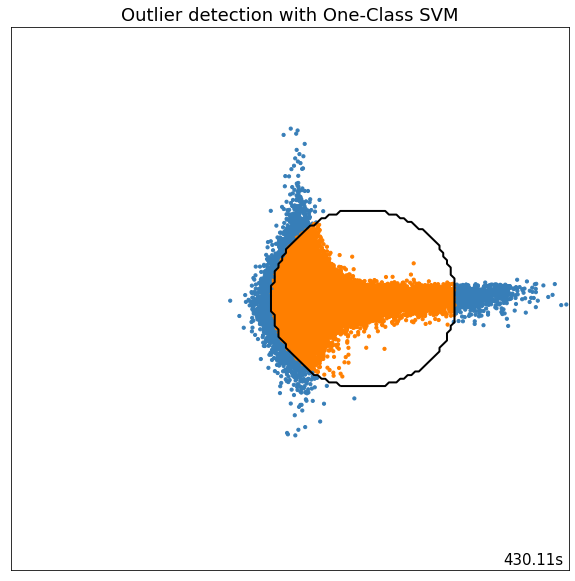

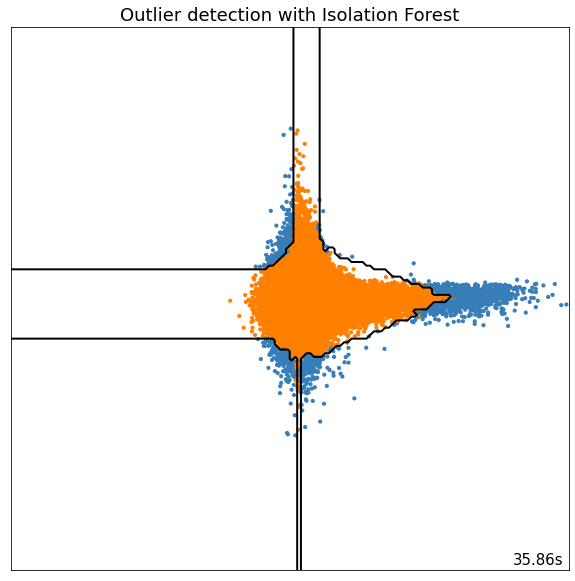

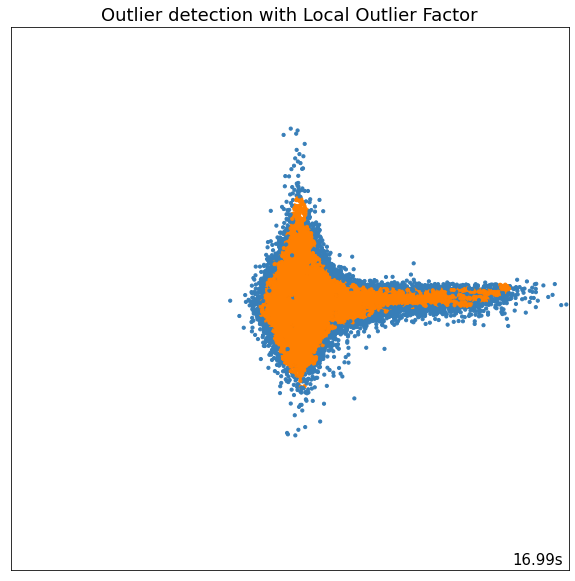

In [14]:
svd_y_preds = compute_and_plot_outliers(svd_vectorized_complaints)

Get all complaint ids that are labelled as outliers.

In [15]:
def get_outlier_ids(y_pred):
    outlier_ids = []

    for id in range(0, len(y_pred)):
        if y_pred[id] == -1:
            outlier_ids.append(id)
    
    return outlier_ids

Get all outliers per algorithm (PCA).

In [16]:
pca_outlier_ids = []
for o in range(0, len(pca_y_preds)):
    outliers = get_outlier_ids(pca_y_preds[o])
    pca_outlier_ids.append(outliers)
    
    print('#outliers:', len(outliers))

#outliers: 4857
#outliers: 4858
#outliers: 4857
#outliers: 4857


Get the intersection of the four outlier detection algorithms when using PCA.

In [20]:
pca_outliers_intersection = list(set(pca_outlier_ids[0]) & set(pca_outlier_ids[1]) & set(pca_outlier_ids[2]) & set(pca_outlier_ids[3]))
print('# of common outliers in all four outlier detection algorithms using PCA:', len(pca_outliers_intersection))

# of common outliers in all four outlier detection algorithms using PCA: 649


In [21]:
print(pca_outliers_intersection)

[456706, 26629, 38917, 419849, 6155, 18451, 319510, 387096, 110616, 374811, 155679, 292896, 315426, 292898, 344101, 88115, 67645, 383045, 333894, 114759, 227400, 51273, 143434, 481373, 278624, 182368, 247904, 278632, 86123, 18541, 153718, 411774, 440448, 333959, 282778, 28827, 139420, 374943, 389286, 338090, 171, 475310, 284846, 403640, 368833, 112835, 329925, 112837, 350407, 41160, 92370, 436435, 28882, 51425, 159972, 155879, 338151, 250088, 190698, 33005, 397549, 153840, 237809, 254194, 286964, 411895, 114936, 430329, 149758, 239870, 207104, 387326, 413950, 139523, 143620, 209157, 473351, 176398, 239889, 338193, 282901, 78106, 477469, 31005, 153891, 375075, 383269, 239910, 420134, 364838, 469291, 272684, 92462, 481582, 180528, 368950, 379195, 356668, 305481, 282958, 346447, 168279, 227676, 117090, 285029, 471400, 287084, 399731, 239994, 24955, 78204, 285050, 194940, 49538, 340354, 242053, 260491, 24974, 133519, 70035, 416154, 371100, 389538, 280999, 274855, 117163, 2477, 442799, 2748

In [26]:
print(dataset['Consumer complaint narrative'][456706])

On XX/XX/XXXX, I purchased 3 Certificate of Deposits, totaling {$800000.00}, from a company fraudulently represented as XXXX XXXX XXXX ( XXXX ), located at XXXX XXXX XXXX, XXXX XXXX, XXXX. My belief is there were errors in the banking processes of XXXX XXXX XXXXXXXX ( XXXX ) and Citibank N.A. ( Citibank ) in their handling of a {$800000.00} wire funds transfer, which was for the purchase of fraudulently represented Certificate of Deposits. My request is for the reimbursement of the {$800000.00} of stolen funds, updating of the all KYC databases with the fraudsters information discovered on this case, and the hopeful improvement of the Financial Institutions wire funds transfer processes to correct conflicting information or improperly utilized  fields on the forms customers sign to authorize the transfers. 

XXXX XXXX XXXXXXXX : There was a fraud prevention process breakdown regarding the critical issue of wiring my funds to an international HIGH-THREAT region. I was presented, and sig

In [27]:
print(dataset['Consumer complaint narrative'][26629])

My mortgage company did not pay my property taxes on time.


In [28]:
print(dataset['Consumer complaint narrative'][38917])

They accepted my deposit but tell me have company do stop payment they are n't closing my account as instructed or giving me my money XXXX


In [29]:
print(dataset['Consumer complaint narrative'][419849])

There were account open for capital one Bank USA NA.XXXX XXXX XXXX UT XXXX onXX/XX/2019 which I didn't open..I had call capital one creditor there don't see anything on file on my name. Could you please check it out for me please thanks


In [30]:
print(dataset['Consumer complaint narrative'][6155])

I am trying to update my address with Capital One to the USPS standard of XXXX XXXX XXXX XXXX, XXXX, WI XXXX, but they claim my new address in in XXXX which is incorrect and I do not want it reported to the credit agencies as such, but they will not correct their system issue


In [31]:
print(dataset['Consumer complaint narrative'][18451])

XXXX breached contract against XXXX XXXX, thus patient not liable for XXXX fees.


In [32]:
print(dataset['Consumer complaint narrative'][319510])

I've contacted Transunion to remove XXXX XXXX XXXX XXXX due to the debt being paid and is currently not a collection. It is still stating as a collection on my credit report.


In [33]:
print(dataset['Consumer complaint narrative'][387096])

I could not get my report online from Equifax and XXXX


In [34]:
print(dataset['Consumer complaint narrative'][110616])

I have inquiries from Equifax that were unauthorized. Equifax do not want to investigate in to the situation for me


In [35]:
print(dataset['Consumer complaint narrative'][374811])

Theyre removing good accounts XXXX and XXXX


___

Get the outliers detected with the robust covariance algorithm using PCA but with the intersection excluded.

In [36]:
pca_outliers_robust_covariance = list(set(pca_outlier_ids[0]) ^ set(pca_outliers_intersection))
len(pca_outliers_robust_covariance)

4208

In [37]:
print(pca_outliers_robust_covariance[:100])
print('...')

[409600, 286729, 425994, 425995, 483338, 409613, 352271, 360468, 385045, 73750, 8215, 221210, 155678, 483361, 24612, 286760, 393257, 417832, 319534, 213039, 106544, 139313, 65586, 352304, 139318, 335927, 57400, 155705, 8258, 376903, 98375, 90185, 344141, 8272, 213073, 8274, 245843, 303187, 41046, 204886, 426075, 368732, 196701, 458844, 393312, 204898, 303209, 385130, 106604, 106608, 344182, 319608, 254073, 303228, 303231, 254082, 134, 442503, 123019, 98445, 147598, 278669, 16528, 221335, 180376, 368791, 73885, 229535, 254114, 32933, 24743, 65708, 123054, 417971, 32948, 98484, 352438, 377013, 377016, 32954, 204986, 327870, 8385, 82114, 245955, 426178, 204999, 417993, 57546, 188619, 450768, 426194, 467157, 57561, 164059, 426204, 49373, 377053, 311520, 123105]
...


In [38]:
print(dataset['Consumer complaint narrative'][409600])

I tried to transfer money that I have had on XXXX for months because I'm in need of it. and when I tried to transfer it said that capital one has blocked me from receiving it.


In [39]:
print(dataset['Consumer complaint narrative'][286729])

XXXX ID : XXXX my account was limited XXXX and funds hasn't been released


In [40]:
print(dataset['Consumer complaint narrative'][425994])

My husband and I printed our credit report, and there was a judgement on the report from 2011. We paid this years ago, after going to the State and getting a print off of Satisfaction of Lien, we then went to the XXXX XXXX XXXX court, who explained we would have to submit a complaint to each reporting bureau.


In [41]:
print(dataset['Consumer complaint narrative'][425995])

Social security Admin. reporting my overpayment as not paid is incorrect. Paid on time.


In [42]:
print(dataset['Consumer complaint narrative'][483338])

it my belief, base discrimintion ( treatment )


___

Get the outliers detected with the one-class SVM algorithm using PCA but with the intersection excluded.

In [43]:
pca_outliers_one_class_svm = list(set(pca_outlier_ids[1]) ^ set(pca_outliers_intersection))
len(pca_outliers_one_class_svm)

4209

In [44]:
print(pca_outliers_one_class_svm[:100])
print('...')

[204803, 245765, 90119, 425994, 409613, 303119, 311312, 393234, 393236, 385045, 253974, 245785, 319513, 180252, 466975, 483361, 434210, 24612, 311337, 319534, 213039, 106544, 376881, 65586, 254004, 81973, 57400, 368697, 352314, 98368, 245825, 8258, 204868, 278597, 24647, 98375, 49225, 90185, 41036, 188493, 385101, 8274, 245843, 303187, 41046, 204886, 262234, 458844, 163934, 155743, 450654, 98402, 180323, 458850, 436384, 385130, 106604, 319597, 385133, 98415, 344182, 49273, 368764, 114813, 82051, 106632, 188557, 237714, 295061, 150, 221337, 458906, 73885, 229535, 311457, 327841, 270500, 90277, 131237, 377002, 65708, 73901, 426159, 377013, 204986, 180411, 327870, 352447, 426174, 82114, 229570, 286914, 204999, 336074, 467157, 418006, 180445, 368864, 82146, 385250]
...


In [46]:
print(dataset['Consumer complaint narrative'][204803])

In XXXX of XXXX, we refinanced our home through XXXX XXXX XXXX in XXXX, VA. In XXXX of that year, XXXX XXXX XXXX sold the loan to XXXX XXXXXXXX XXXX. In XXXX of that year, we re-financed again because we did not like the customer service from XXXX. We re-financed with XXXX which is now XXXX XXXX. In XXXX, Capital One purchased XXXX. In XXXX, we opened a second equity line with XXXX XXXX XXXX in second position. At that time, nothing was found during the title search. When the loan came up for renewal in XXXX, we applied for a renewal. During the title search, an unreleased loan through XXXX XXXX was discovered. I have the HUD Settlement statements from the XXXX loan and the XXXX loan showing that XXXX was paid as well as the letter from XXXX informing us that they had purchased the loan. I called Capital One to ask for a release. The customer service person was able to see the loan number and my name, but had no other information in the system. She refused to send a release. She said s

In [47]:
print(dataset['Consumer complaint narrative'][245765])

EXCUSE THE CATAGORY CHOICE BUT THERES NO OPTION FOR ''CREDIT REPORTING FELONY FRAUD '' AND DEFAMATION OF CHARACTER '' I DONT UNDERSTAND HOW THESE CRIMINALS KEEP GETTING AWAY WITH THIER FRIVOLOUS REPORTS WITHOUT HAVING ANY PROOF OF ANY DEBT,,,,, ,AND NO PROOF OF ANY WRONG DOING,,,,,,,,, NO SWORN AFFIDAVIT THAT HAS BEEN NOTARIZED,,, ,BUT YET XXXX   REMAINS IN BUSINESS OF EXTORTION, WHAT A XXXX PLACE THIS IS,,, CHEXSYSTEMS IS A RICO-EXTORTION RAQUET, THIER PARTNERS IN CRIME HAVE ABSOLUTELY NO EVIDENCE OF A DEBT OWED OR AN INJURED PARTY, I HAVE NEVER RECEIVED A REPORT ON ANYTHING THEYRE REPORTING ON, WHICH IS A MAJOR VIOLATION OF MY RIGHTS AND A VIOLATION OF FRCPA RULES, I AM IN NO WAY OBLIGATED TO GIVE XXXX  MY BIRTHDAY OR SS NUMBER EITHER, CHEXSYSTEMS USES DEFORMATORY INFORMATION ON ME WITHOUT HAVING ABSOLUTELY NO PROOF OF A DEBT OR WRONG-DOING COMMITTED BY ME,, CHEXSYSTEMS COMMITS 2ND DEGREE FELONY BY USING MY PERSONAL INFORMATION WITHOUT MY CONSENT, ALSO RECENTLY I WENT INTO XXXX XXXX 

In [48]:
print(dataset['Consumer complaint narrative'][90119])

CFPB is full of complaints about XXXX. On information and belief, XXXX entered into a settlement agreement for previous bad deeds involving their interaction and conduct with their customers. I have previously attempted to get this matter resolved with XXXX. I recently was contacted by the XXXX CEO Office who indicated they would contact me within two days, that was some weeks ago, and to date I have heard nothing back. I have attached four XXXX 's from XXXX, Cancelling Debt. The issue of a XXXX to the IRS acknowledges XXXX has abandoned all claim to the alleged debt. I previously disputed the debt and provided XXXX verifiable evidence that the debt was based on fraud and not my obligation. I provided XXXX all the law enforcement reports associated with the fraud that I had obtained. XXXX ignored all the evidence and continued to pursue collections. In every case, on each of the four credit cards, XXXX overcharged me for late fees etc. 
XXXX was caught by CFPB and was required to issue

In [49]:
print(dataset['Consumer complaint narrative'][425994])

My husband and I printed our credit report, and there was a judgement on the report from 2011. We paid this years ago, after going to the State and getting a print off of Satisfaction of Lien, we then went to the XXXX XXXX XXXX court, who explained we would have to submit a complaint to each reporting bureau.


In [50]:
print(dataset['Consumer complaint narrative'][409613])

XXXX  showing XXXX, XXXX, exp when i sent hacking and ftc reports


___

Get the outliers detected with the isolation forest algorithm using PCA but with the intersection excluded.

In [51]:
pca_outliers_isolation_forest = list(set(pca_outlier_ids[2]) ^ set(pca_outliers_intersection))
len(pca_outliers_isolation_forest)

4208

In [52]:
print(pca_outliers_isolation_forest[:100])
print('...')

[409600, 245765, 286729, 425994, 409613, 344078, 352271, 360468, 385045, 73750, 8215, 245785, 221210, 180252, 155678, 466975, 483361, 434210, 24612, 311337, 213039, 106544, 139313, 65586, 352304, 81973, 139318, 335927, 57400, 155705, 245825, 8258, 98375, 49225, 90185, 254028, 344141, 8272, 213073, 8274, 245843, 303187, 41046, 204886, 426075, 458844, 196701, 393312, 204898, 180323, 385130, 106604, 106608, 311414, 344182, 319608, 254073, 303228, 134, 98445, 147598, 188557, 16528, 278669, 368791, 180376, 73885, 229535, 32933, 303269, 24743, 327847, 65708, 417971, 98484, 377013, 352438, 377016, 32954, 204986, 327870, 352447, 82114, 245955, 426178, 204999, 417993, 57546, 188619, 450768, 426194, 467157, 57561, 164059, 426204, 49373, 311520, 147682, 319721, 246002]
...


In [53]:
print(dataset['Consumer complaint narrative'][409600])

I tried to transfer money that I have had on XXXX for months because I'm in need of it. and when I tried to transfer it said that capital one has blocked me from receiving it.


In [54]:
print(dataset['Consumer complaint narrative'][245765])

EXCUSE THE CATAGORY CHOICE BUT THERES NO OPTION FOR ''CREDIT REPORTING FELONY FRAUD '' AND DEFAMATION OF CHARACTER '' I DONT UNDERSTAND HOW THESE CRIMINALS KEEP GETTING AWAY WITH THIER FRIVOLOUS REPORTS WITHOUT HAVING ANY PROOF OF ANY DEBT,,,,, ,AND NO PROOF OF ANY WRONG DOING,,,,,,,,, NO SWORN AFFIDAVIT THAT HAS BEEN NOTARIZED,,, ,BUT YET XXXX   REMAINS IN BUSINESS OF EXTORTION, WHAT A XXXX PLACE THIS IS,,, CHEXSYSTEMS IS A RICO-EXTORTION RAQUET, THIER PARTNERS IN CRIME HAVE ABSOLUTELY NO EVIDENCE OF A DEBT OWED OR AN INJURED PARTY, I HAVE NEVER RECEIVED A REPORT ON ANYTHING THEYRE REPORTING ON, WHICH IS A MAJOR VIOLATION OF MY RIGHTS AND A VIOLATION OF FRCPA RULES, I AM IN NO WAY OBLIGATED TO GIVE XXXX  MY BIRTHDAY OR SS NUMBER EITHER, CHEXSYSTEMS USES DEFORMATORY INFORMATION ON ME WITHOUT HAVING ABSOLUTELY NO PROOF OF A DEBT OR WRONG-DOING COMMITTED BY ME,, CHEXSYSTEMS COMMITS 2ND DEGREE FELONY BY USING MY PERSONAL INFORMATION WITHOUT MY CONSENT, ALSO RECENTLY I WENT INTO XXXX XXXX 

In [55]:
print(dataset['Consumer complaint narrative'][286729])

XXXX ID : XXXX my account was limited XXXX and funds hasn't been released


In [56]:
print(dataset['Consumer complaint narrative'][425994])

My husband and I printed our credit report, and there was a judgement on the report from 2011. We paid this years ago, after going to the State and getting a print off of Satisfaction of Lien, we then went to the XXXX XXXX XXXX court, who explained we would have to submit a complaint to each reporting bureau.


In [57]:
print(dataset['Consumer complaint narrative'][409613])

XXXX  showing XXXX, XXXX, exp when i sent hacking and ftc reports


___

Get the outliers detected with the local outlier factor algorithm using PCA but with the intersection excluded.

In [58]:
pca_outliers_local_outlier_factor = list(set(pca_outlier_ids[3]) ^ set(pca_outliers_intersection))
len(pca_outliers_local_outlier_factor)

4208

In [59]:
print(pca_outliers_local_outlier_factor[:100])
print('...')

[212996, 245765, 237576, 155657, 344078, 303119, 147472, 393234, 417811, 73750, 245785, 475161, 106524, 139297, 426021, 73766, 81958, 196647, 311337, 417835, 24621, 319534, 352304, 139313, 245811, 24628, 376891, 204862, 114751, 245825, 450625, 475207, 254028, 376908, 180304, 57428, 65627, 155743, 475232, 41058, 458850, 229482, 417899, 385133, 401517, 98415, 106608, 147569, 344178, 73843, 442484, 229493, 426105, 24699, 385147, 114813, 188542, 196734, 131205, 262281, 98445, 188557, 16528, 180369, 146, 237714, 467091, 295061, 442522, 73884, 311457, 237731, 82084, 32933, 262308, 303269, 327847, 368810, 475307, 73901, 426159, 16567, 32951, 229559, 377015, 90300, 147647, 352447, 196801, 360639, 377027, 426178, 196805, 417989, 131271, 57544, 139465, 245961, 336075, 245969]
...


In [61]:
print(dataset['Consumer complaint narrative'][212996])

The company has placed multiple delinquent notices on my credit causing emotional distress. They also started to garnish my wages and continue to Harass me with phone calls I have documented all phone calls and letters they have sent regarding garnishment and money owed. I have informed the company that if they do not delete the accounts from my credit I will be taking legal action


In [62]:
print(dataset['Consumer complaint narrative'][245765])

EXCUSE THE CATAGORY CHOICE BUT THERES NO OPTION FOR ''CREDIT REPORTING FELONY FRAUD '' AND DEFAMATION OF CHARACTER '' I DONT UNDERSTAND HOW THESE CRIMINALS KEEP GETTING AWAY WITH THIER FRIVOLOUS REPORTS WITHOUT HAVING ANY PROOF OF ANY DEBT,,,,, ,AND NO PROOF OF ANY WRONG DOING,,,,,,,,, NO SWORN AFFIDAVIT THAT HAS BEEN NOTARIZED,,, ,BUT YET XXXX   REMAINS IN BUSINESS OF EXTORTION, WHAT A XXXX PLACE THIS IS,,, CHEXSYSTEMS IS A RICO-EXTORTION RAQUET, THIER PARTNERS IN CRIME HAVE ABSOLUTELY NO EVIDENCE OF A DEBT OWED OR AN INJURED PARTY, I HAVE NEVER RECEIVED A REPORT ON ANYTHING THEYRE REPORTING ON, WHICH IS A MAJOR VIOLATION OF MY RIGHTS AND A VIOLATION OF FRCPA RULES, I AM IN NO WAY OBLIGATED TO GIVE XXXX  MY BIRTHDAY OR SS NUMBER EITHER, CHEXSYSTEMS USES DEFORMATORY INFORMATION ON ME WITHOUT HAVING ABSOLUTELY NO PROOF OF A DEBT OR WRONG-DOING COMMITTED BY ME,, CHEXSYSTEMS COMMITS 2ND DEGREE FELONY BY USING MY PERSONAL INFORMATION WITHOUT MY CONSENT, ALSO RECENTLY I WENT INTO XXXX XXXX 

In [63]:
print(dataset['Consumer complaint narrative'][237576])

I bought a computer from XXXX XXXX but started having problems with them around XX/XX/2015 when XXXX contacted me. I did not know who XXXX was so I called XXXX instead. they stated that they were unable to process my XXXX card. After calling XXXX and XXXX back I was told to now give XXXX the number on the front of the card and NOT the banking and routing number as they previously asked. then everything was fine and they gave me back all late charges they had charged me. They NEVER called me, emailed me or mailed me anything. when I asked them why, they responded that they do not do that?! then a few months later XXXX called me again to say that it was still an issue. I called XXXX, spoke with a supervisor and all was fixed. ALL LATE FEES were given back to me and they were very apologetic. then I found out that they reported these late fees to credit reports. when I called bestbuy again, they agreed they were at fault, apologized again and said that they would fix this with the credit 

In [64]:
print(dataset['Consumer complaint narrative'][155657])

I reached out to you guys on last year regarding some items on my credit that were not mine. There are still a some items that are not mine and needs to be removed. XXXX XXXX XXXX XXXX XXXX XXXX XXXX XXXX XXXX XXXX XXXX XXXX XXXX XXXX XXXX XXXX XXXX XXXX XXXX. I have reached out to the FTC and local police regarding this. I am doing this on my own behalf.


In [65]:
print(dataset['Consumer complaint narrative'][344078])

Citibank, N.A., issuer of my Citibank MasterCard, has knowingly permitted a fraudulent charge to remain on my account. XX/XX/XXXX I agreed to pay {$560.00} to XXXX XXXX XXXX XXXX XXXX XXXX Trucking for transportation of an automobile. My credit card, issued by Citibank, was charged that amount XX/XX/XXXX and services were rendered. Sixty days later, XX/XX/XXXX it came to my attention that an authorization of another charge of {$560.00} had posted as a pending transaction to my credit card and immediately called Citibank. Citibank treated this as a disputed transaction and issued a conditional credit of {$560.00} to my account. I did not receive any indication that further action on my part was needed until XX/XX/XXXX when I saw that a reversal of the conditional credit dated XX/XX/XXXX had appeared on my Citibank statement. At that time, I contacted Citibank to inquire about the return of this fraudulent charge and was informed that XXXX had provided a rebuttal to my dispute and that a

___

Get all outliers per algorithm (SVD).

In [66]:
svd_outlier_ids = []
for o in range(0, len(svd_y_preds)):
    outliers = get_outlier_ids(svd_y_preds[o])
    svd_outlier_ids.append(outliers)
    
    print('#outliers:', len(outliers))

#outliers: 4858
#outliers: 4858
#outliers: 4856
#outliers: 4857


In [67]:
svd_outliers_intersection = list(set(svd_outlier_ids[0]) & set(svd_outlier_ids[1]) & set(svd_outlier_ids[2]) & set(svd_outlier_ids[3]))
print('# of common outliers in all four outlier detection algorithms using SVD:', len(svd_outliers_intersection))

# of common outliers in all four outlier detection algorithms using SVD: 670


In [68]:
outliers_intersections_intersection = list(set(pca_outliers_intersection) & set(svd_outliers_intersection))
print('# of common outliers in both PCA and SVD intersections:', len(outliers_intersections_intersection))

# of common outliers in both PCA and SVD intersections: 625


In [69]:
outliers_robust_covariance_intersection = list(set(pca_outlier_ids[0]) ^ set(svd_outlier_ids[0]))
print('# of common outliers with the robust covariance algorithm with SVD that don\'t occur with PCA:', len(outliers_robust_covariance_intersection))

# of common outliers with the robust covariance algorithm with SVD that don't occur with PCA: 5


In [70]:
outliers_one_class_svm_intersection = list(set(pca_outlier_ids[1]) ^ set(svd_outlier_ids[1]))
print('# of common outliers with the one-class svm algorithm with SVD that don\'t occur with PCA:', len(outliers_one_class_svm_intersection))

# of common outliers with the one-class svm algorithm with SVD that don't occur with PCA: 10


In [71]:
outliers_isolation_forest_intersection = list(set(pca_outlier_ids[0]) ^ set(svd_outlier_ids[0]))
print('# of common outliers with the forest isolation algorithm with SVD that don\'t occur with PCA:', len(outliers_isolation_forest_intersection))

# of common outliers with the forest isolation algorithm with SVD that don't occur with PCA: 5


In [72]:
outliers_local_outlier_factor_intersection = list(set(pca_outlier_ids[0]) ^ set(svd_outlier_ids[0]))
print('# of common outliers with the local outlier factor algorithm with SVD that don\'t occur with PCA:', len(outliers_local_outlier_factor_intersection))

# of common outliers with the local outlier factor algorithm with SVD that don't occur with PCA: 5


PCA and SVD don't result in a big difference so the outlier which where found using PCA will be concidered for outlier removal.
___

The robust covariance algorithm seems to give the best result when inspecting the specific outliers found by it.

In [73]:
print('# of complaints in cleaned_dataset:', cleaned_dataset.shape[0])

# of complaints in cleaned_dataset: 485701


In [74]:
dataset_excluding_outliers = dataset.drop(dataset.index[pca_outlier_ids[0]])
print('# of complaints in cleaned_dataset_excluding_outliers:', dataset_excluding_outliers.shape[0])

# of complaints in cleaned_dataset_excluding_outliers: 480844


Use pickle to save the dataset without outliers to a file.

In [75]:
filename = 'dataset_excluding_outliers.csv'
dataset_excluding_outliers.to_csv(filename, index=False)

In [76]:
import pandas as pd

filename = 'dataset_excluding_outliers.csv'
dataset_excluding_outliers = pd.read_csv(filename) 

In [77]:
print('# of complaints in vectorized_complaints:', len(vectorized_complaints))

# of complaints in vectorized_complaints: 485701


In [78]:
vectorized_complaints_cleaned = []

for index in range(0, len(vectorized_complaints)):
    if index not in pca_outlier_ids[0]:
        vectorized_complaints_cleaned.append(vectorized_complaints[index])

print('# of complaints in vectorized_complaints_cleaned:', len(vectorized_complaints_cleaned))

# of complaints in vectorized_complaints_cleaned: 480844


Use pickle to save the cleaned vectorized complaints to a file.

In [79]:
import pickle

filename = 'vectorized_complaints_cleaned.pkl'
data = vectorized_complaints_cleaned
output = open(filename, 'wb')
pickle.dump(data, output)
output.close()

In [1]:
import pickle

filename = 'vectorized_complaints_cleaned.pkl'
pkl_file = open(filename, 'rb')
data = pickle.load(pkl_file)
pkl_file.close()

## Clustering

Train a hierachical linkage clustering model on the cleaned vectorized complaints.

In [2]:
%%time

from scipy.cluster.hierarchy import linkage, dendrogram

Z = linkage(data[:120000], 'ward')

CPU times: user 1h 8min 40s, sys: 7min 48s, total: 1h 16min 29s
Wall time: 1h 16min 22s


Save the model to a file.

In [3]:
import pickle

filename = 'hierarchical_linkage_model.pkl'
data = Z
output = open(filename, 'wb')
pickle.dump(data, output)
output.close()

In [47]:
import pickle
import numpy as np

filename = 'hierarchical_linkage_model.pkl'
pkl_file = open(filename, 'rb')
linkage_model = pickle.load(pkl_file)
pkl_file.close()

Plot the dendrogram computed from the linkage clustering.

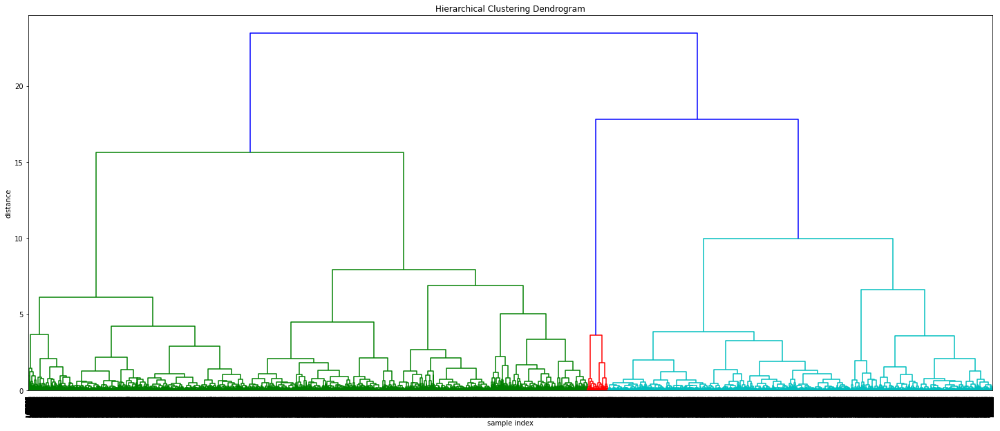

In [8]:
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import dendrogram

plt.figure(figsize=(25, 10))
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('sample index')
plt.ylabel('distance')

dendrogram(
    linkage_model,
    leaf_rotation=90., # rotates the x axis labels
    leaf_font_size=8., # font size for the x axis labels
)

plt.show()

Plot the truncated dendrogram.

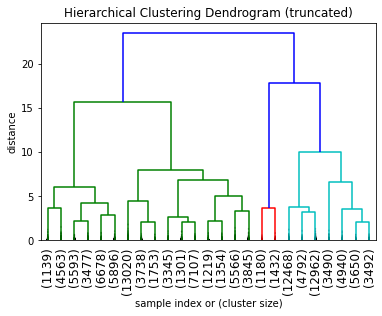

In [9]:
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import dendrogram

plt.title('Hierarchical Clustering Dendrogram (truncated)')
plt.xlabel('sample index or (cluster size)')
plt.ylabel('distance')

dendrogram(
    linkage_model,
    truncate_mode='lastp', # show only the last p merged clusters
    p=25, # show only the last p merged clusters
    leaf_rotation=90.,
    leaf_font_size=12.,
    show_contracted=True, # to get a distribution impression in truncated branches
)

plt.show()

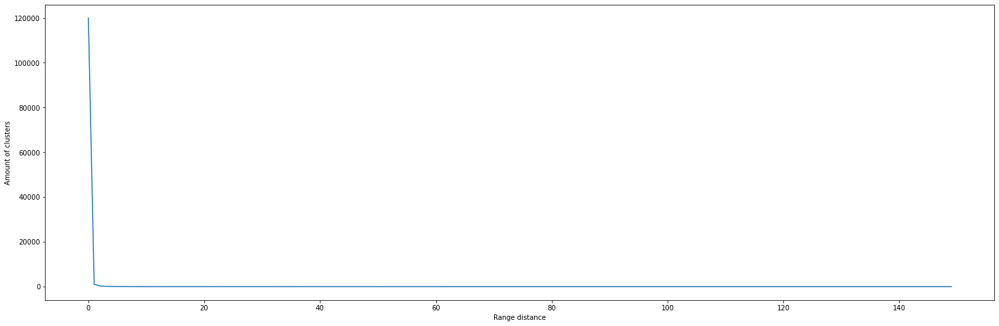

In [13]:
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import fcluster
import numpy as np

cluster_sizes = []

plt.figure(figsize=(25,8))

for x in np.arange(0,30,0.2):
    max_d = x
    clusters = fcluster(linkage_model, max_d, criterion='distance')
    cluster_sizes.append(len(set(clusters)))

plt.plot(cluster_sizes)
plt.xlabel("Range distance")
plt.ylabel("Amount of clusters")
plt.show()

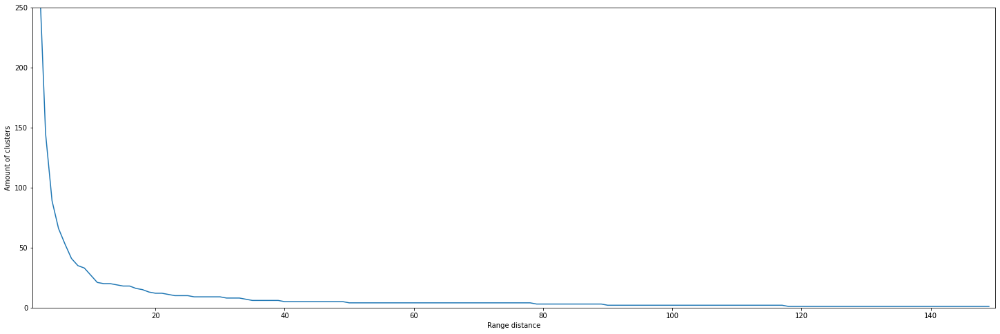

In [82]:
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import fcluster

cluster_sizes = []

plt.figure(figsize=(25,8))

for x in np.arange(0,30,0.2):
    max_d = x
    clusters = fcluster(linkage_model, max_d, criterion='distance')
    cluster_sizes.append(len(set(clusters)))

plt.plot(cluster_sizes)
plt.xlim(1,150)
plt.ylim(0,250)
plt.xlabel("Range distance")
plt.ylabel("Amount of clusters")
plt.show()

In [44]:
import pandas as pd

filename = 'dataset_excluding_outliers.csv'
dataset_excluding_outliers = pd.read_csv(filename) 

In [84]:
prev = 0
for i in range(8, len(cluster_sizes)):
    if prev == cluster_sizes[i]: continue
    print("Range distance:", round(i*0.2, 2), "( i = ", i,")" " gives", cluster_sizes[i], " clusters\n")
    prev = cluster_sizes[i]

Range distance: 1.6 ( i =  8 ) gives 35  clusters

Range distance: 1.8 ( i =  9 ) gives 33  clusters

Range distance: 2.0 ( i =  10 ) gives 27  clusters

Range distance: 2.2 ( i =  11 ) gives 21  clusters

Range distance: 2.4 ( i =  12 ) gives 20  clusters

Range distance: 2.8 ( i =  14 ) gives 19  clusters

Range distance: 3.0 ( i =  15 ) gives 18  clusters

Range distance: 3.4 ( i =  17 ) gives 16  clusters

Range distance: 3.6 ( i =  18 ) gives 15  clusters

Range distance: 3.8 ( i =  19 ) gives 13  clusters

Range distance: 4.0 ( i =  20 ) gives 12  clusters

Range distance: 4.4 ( i =  22 ) gives 11  clusters

Range distance: 4.6 ( i =  23 ) gives 10  clusters

Range distance: 5.2 ( i =  26 ) gives 9  clusters

Range distance: 6.2 ( i =  31 ) gives 8  clusters

Range distance: 6.8 ( i =  34 ) gives 7  clusters

Range distance: 7.0 ( i =  35 ) gives 6  clusters

Range distance: 8.0 ( i =  40 ) gives 5  clusters

Range distance: 10.0 ( i =  50 ) gives 4  clusters

Range distance: 15.

The cluster sizes are going down real fast to 'small' numbers. For practical reasons, only the clusters between 22 and 5 will be analyzed. In this analysis, the Customer Complaints will be manually analyzed to find the optimal amount of clusters.

In [48]:
import random
from scipy.cluster.hierarchy import fcluster

cluster_sizes = [9, 10, 11, 12, 14, 15, 17, 18, 19, 20, 22, 23, 26, 31, 34, 35, 40]
clusters = []
doc_by_clusters = []

for i in cluster_sizes: # Voor elke cluster
    cluster = fcluster(linkage_model, i*0.2, criterion='distance')
    clusters.append(cluster)
    
    # Dict, key = cluster, value = document
    doc_by_cluster = {}
    
    for index in range(len(cluster)):
        if cluster[index] not in doc_by_cluster.keys():
            doc_by_cluster[cluster[index]] = []
        doc_by_cluster[cluster[index]].append(index)
    
    doc_by_clusters.append(doc_by_cluster)

In [86]:
import collections

i = 0
for cluster in doc_by_clusters:
    # cluster = dict where key = cluster and value = document
    print('\033[1m')
    print('Cluster size of', len(cluster), '\033[0m')
    print('==================')
    cluster = collections.OrderedDict(sorted(cluster.items()))
    
    for i in cluster.keys():
        for x in range(3):
            random_int = random.randint(0,len(cluster[i])-1)
            print("Cluster:", i, "/", len(cluster), "with random doc:", cluster[i][random_int], "\n")
            print("\t",dataset_excluding_outliers['Consumer complaint narrative'][cluster[i][random_int]] )
            print("\n\n")
    print("----------------------------------------------------------------------------------------------------------")
    print("----------------------------------------------------------------------------------------------------------")
    print("\n\n")


Cluster size of 33 
Cluster: 1 / 33 with random doc: 72544 

	 I was victim of Identity Theft, somebody used my personal information to open credit cards and get loans, i don't recognize any of this accounts and inquiries. Except as otherwise provided in this section, a consumer reporting agency shall block the reporting of any information in the file of a consumer that the consumer identifies as information that resulted from an alleged identity theft, not later than 4 business days after the date of receipt by such agency of ( 1 ) appropriate proof of the identity of the consumer ; ( 2 ) a copy of an identity theft report ; ( 3 ) the identification of such information by the consumer ; and ( 4 ) a statement by the consumer that the information is not information relating to any transaction by the consumer. ( b ) Notification. A consumer reporting agency shall promptly notify the furnisher of information identified by the consumer under subsection ( a ) of this section ( 1 ) that the

In [49]:
clustered_dataset = dataset_excluding_outliers[:120000]
for cs in range(len(cluster_sizes)):
    cluster_name = "range_distance_" + str(round(cluster_sizes[cs]*0.2,2))
    print(cluster_name)
    clustered_dataset[cluster_name] = clusters[cs]

clustered_dataset.head()

range_distance_1.8
range_distance_2.0
range_distance_2.2
range_distance_2.4
range_distance_2.8
range_distance_3.0
range_distance_3.4
range_distance_3.6
range_distance_3.8
range_distance_4.0
range_distance_4.4
range_distance_4.6
range_distance_5.2
range_distance_6.2
range_distance_6.8
range_distance_7.0
range_distance_8.0


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


,Unnamed: 0,Date received,Product,Sub-product,Issue,Sub-issue,Consumer complaint narrative,Company public response,Company,State,...,range_distance_3.6,range_distance_3.8,range_distance_4.0,range_distance_4.4,range_distance_4.6,range_distance_5.2,range_distance_6.2,range_distance_6.8,range_distance_7.0,range_distance_8.0
0,250000,02/17/17,Mortgage,Conventional fixed mortgage,"Loan servicing, payments, escrow account",None,My husband XXXX XXXX passed away on XXXX/XXXX/...,Company has responded to the consumer and the ...,WELLS FARGO & COMPANY,TX,...,3,2,2,2,2,2,1,1,1,1
1,250001,03/31/17,Mortgage,Conventional fixed mortgage,"Loan servicing, payments, escrow account",None,Extortion excess escrow ; with threatened Fore...,Company believes it acted appropriately as aut...,Ditech Financial LLC,MI,...,12,10,10,9,8,7,6,6,5,4
2,250002,04/07/17,Debt collection,"Other (i.e. phone, health club, etc.)",Improper contact or sharing of info,Talked to a third party about my debt,I do not have a contract with Diversified Cons...,None,"Diversified Consultants, Inc.",MO,...,12,10,10,9,8,7,6,6,5,4
3,250003,03/24/17,Consumer Loan,Title loan,Payment to acct not credited,None,"A 20 year loan at .0875 simple interest, in XX...",None,PNC Bank N.A.,FL,...,5,4,4,3,3,3,2,2,2,2
4,250004,08/05/15,Debt collection,I do not know,Cont'd attempts collect debt not owed,Debt is not mine,"I continue to get calls from this company, I b...",None,High Point Asset Inc,DE,...,13,11,10,9,8,7,6,6,5,4


In [15]:
import pandas as pd

filename = 'dataset_excluding_outliers.csv'
cleaned_dataset_excluding_outliers = pd.read_csv(filename) 

In [16]:
import re

# drop columns that aren't going to be used
cleaned_dataset_excluding_outliers = cleaned_dataset_excluding_outliers.drop(['Unnamed: 0', 'Date received', 'Company', 'State', 'ZIP code', 'Tags', 'Consumer consent provided?', 'Submitted via', 'Company response to consumer', 'Timely response?', 'Date sent to company', 'Consumer disputed?', 'Complaint ID'], axis=1)
# remove useless text parts
cleaned_dataset_excluding_outliers['Consumer complaint narrative'] = cleaned_dataset_excluding_outliers['Consumer complaint narrative'].replace(to_replace='xx/xx/\d{4}|XX/XX/\d{4}|\d\d/\d\d/\d{4}|xx/xx/\d{2}|XX/XX/\d{2}|\d\d/\d\d/\d{2}|xx+|XX+|{|}|\$\d+(\.\d+)?', value='', regex=True)
# replace consecutive spaces by only one space
cleaned_dataset_excluding_outliers['Consumer complaint narrative'] = cleaned_dataset_excluding_outliers['Consumer complaint narrative'].replace(to_replace='\s\s+', value=' ', regex=True)

In [17]:
%%time

cleaned_dataset_excluding_outliers['Consumer complaint narrative'] = clean_col(cleaned_dataset_excluding_outliers['Consumer complaint narrative'])

CPU times: user 23min 50s, sys: 15.2 s, total: 24min 5s
Wall time: 24min 6s



Cluster size of 33 
Cluster: 1 / 33


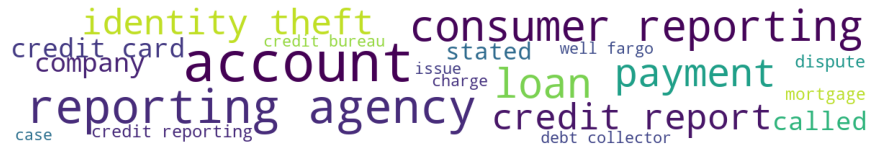



Cluster: 2 / 33


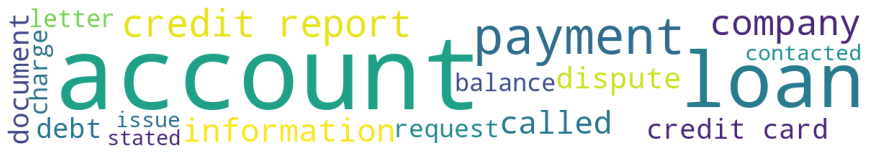



Cluster: 3 / 33


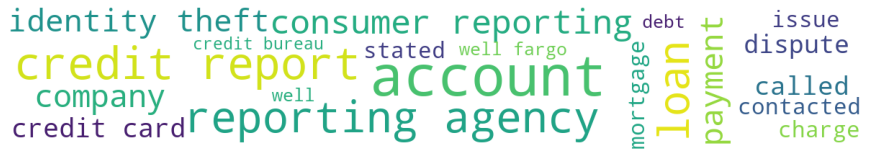



Cluster: 4 / 33


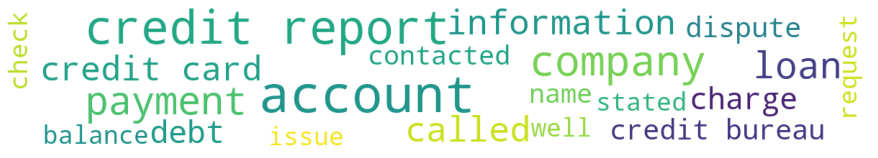



Cluster: 5 / 33


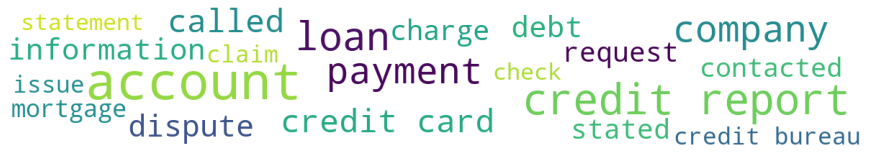



Cluster: 6 / 33


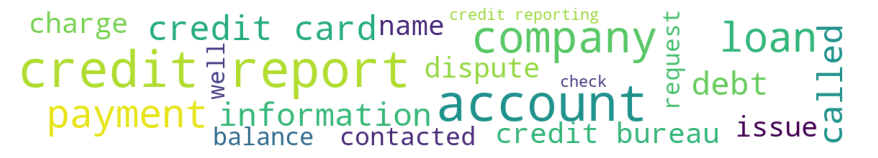



Cluster: 7 / 33


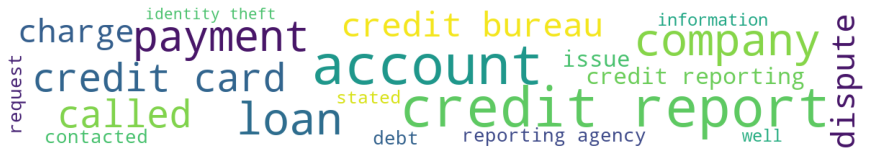



Cluster: 8 / 33


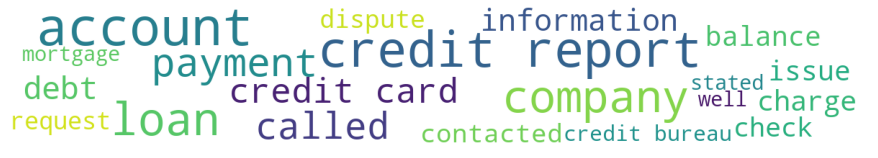



Cluster: 9 / 33


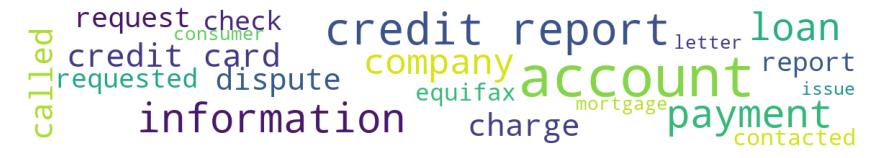



Cluster: 10 / 33


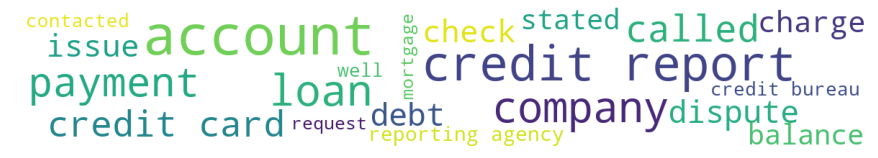



Cluster: 11 / 33


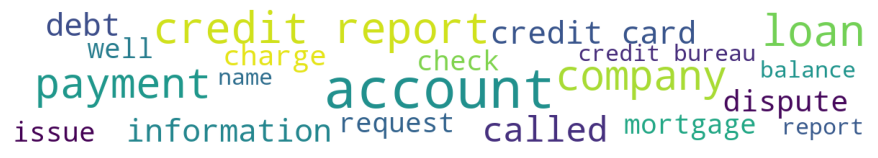



Cluster: 12 / 33


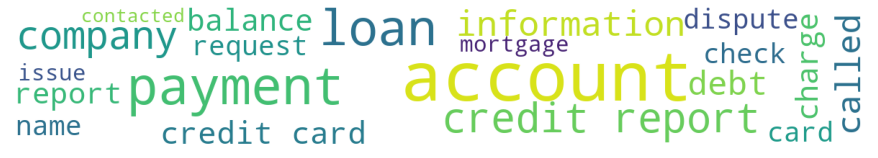



Cluster: 13 / 33


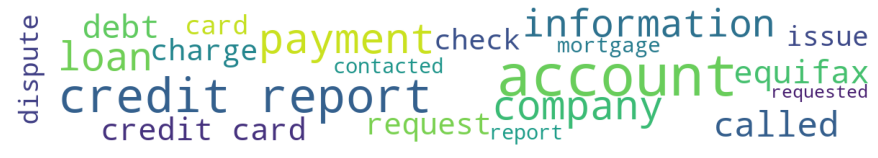



Cluster: 14 / 33


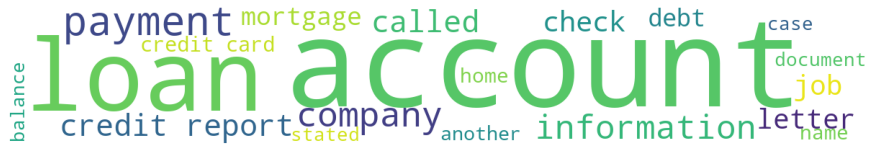



Cluster: 15 / 33


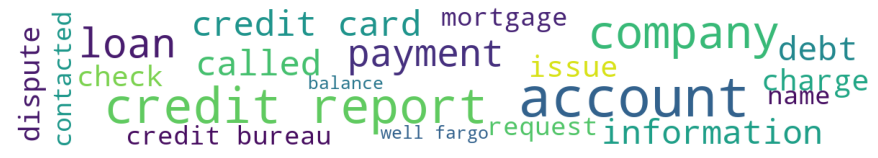



Cluster: 16 / 33


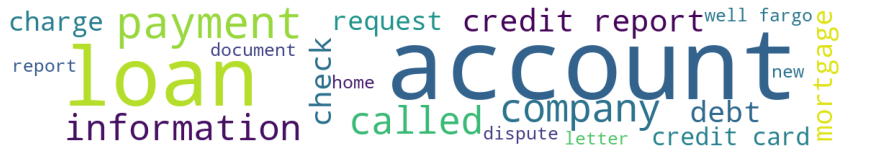



Cluster: 17 / 33


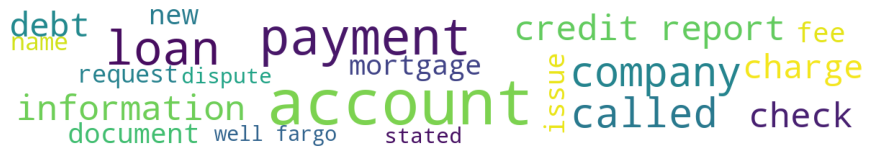



Cluster: 18 / 33


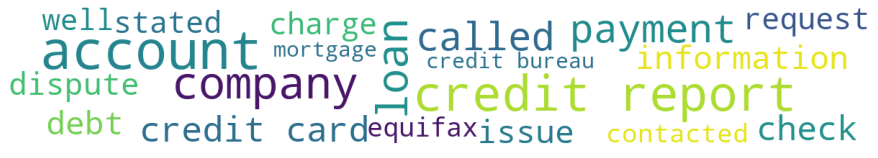



Cluster: 19 / 33


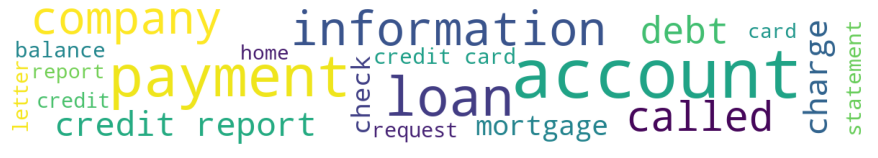



Cluster: 20 / 33


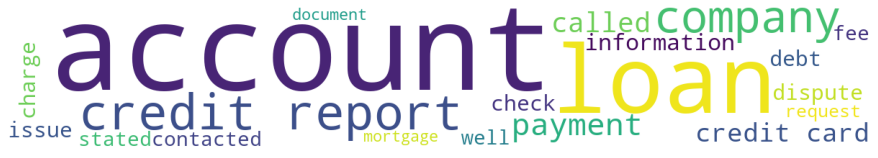



Cluster: 21 / 33


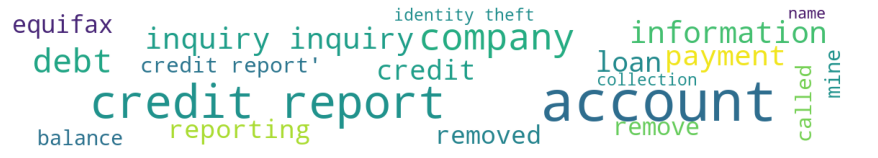



Cluster: 22 / 33


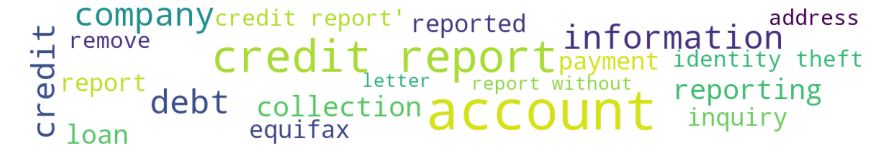



Cluster: 23 / 33


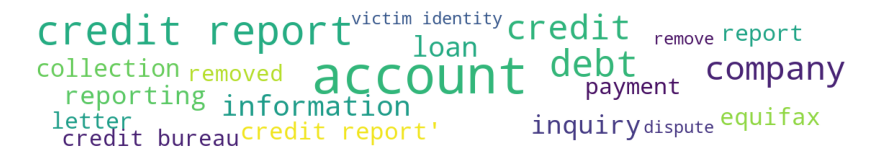



Cluster: 24 / 33


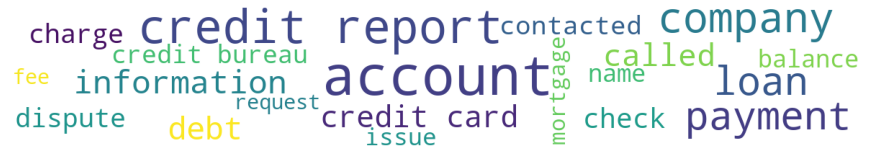



Cluster: 25 / 33


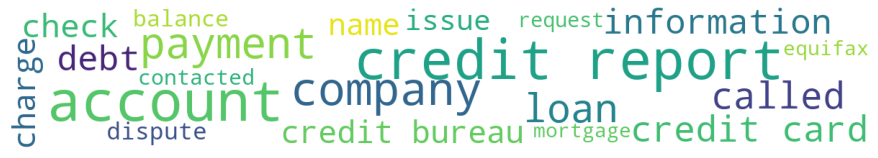



Cluster: 26 / 33


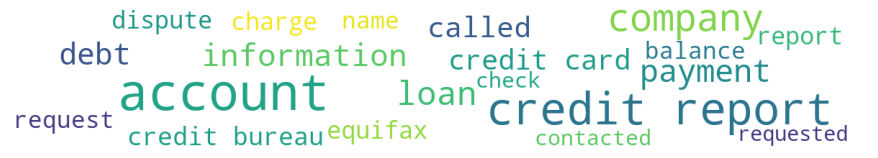



Cluster: 27 / 33


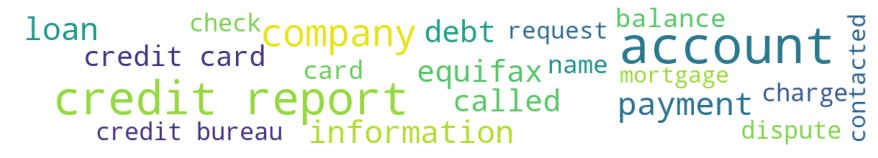



Cluster: 28 / 33


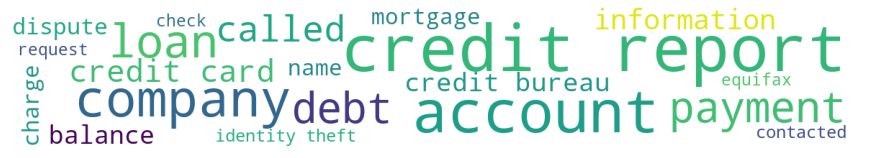



Cluster: 29 / 33


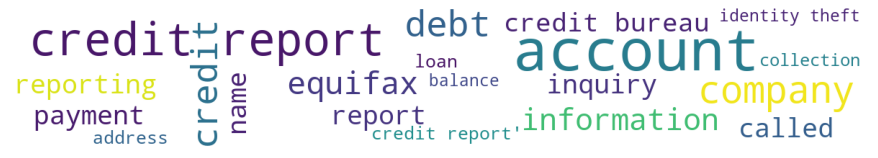



Cluster: 30 / 33


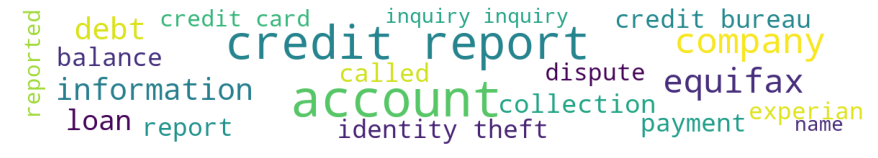



Cluster: 31 / 33


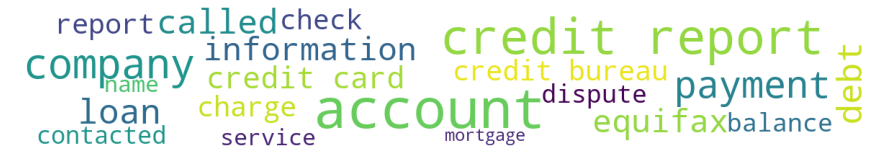



Cluster: 32 / 33


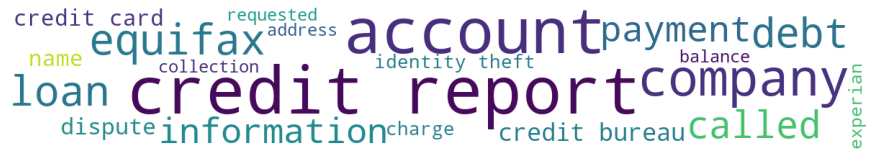



Cluster: 33 / 33


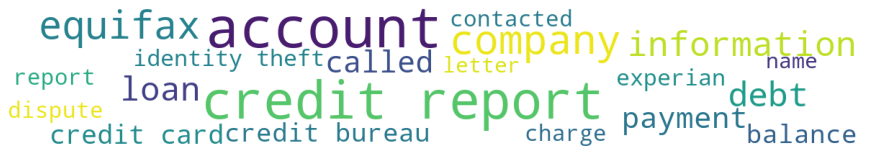




Cluster size of 27 
Cluster: 1 / 27


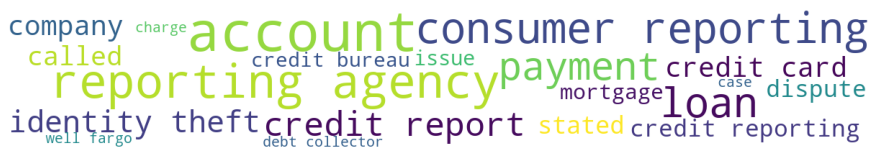



Cluster: 2 / 27


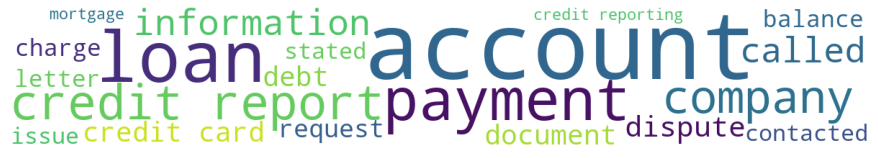



Cluster: 3 / 27


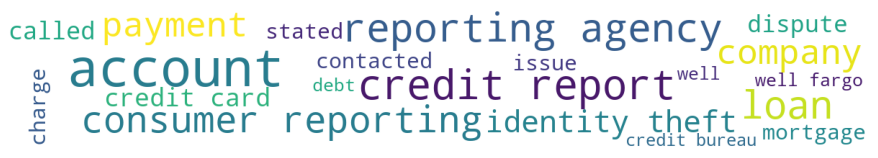



Cluster: 4 / 27


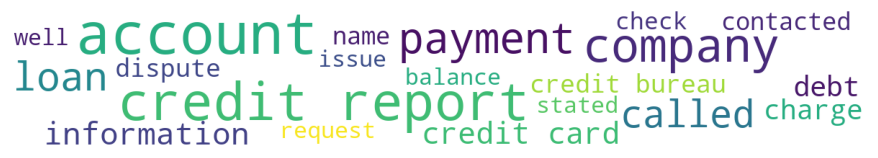



Cluster: 5 / 27


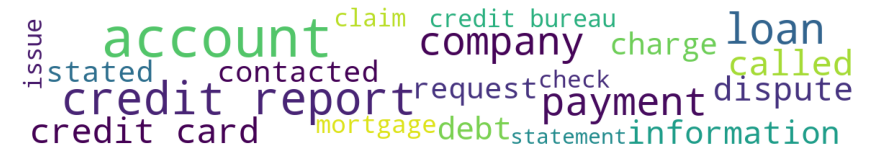



Cluster: 6 / 27


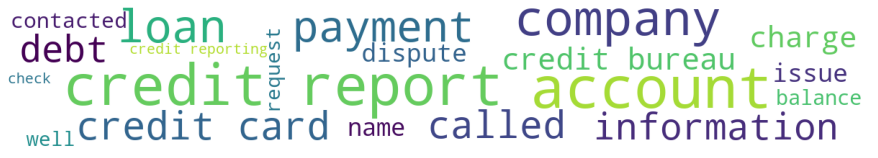



Cluster: 7 / 27


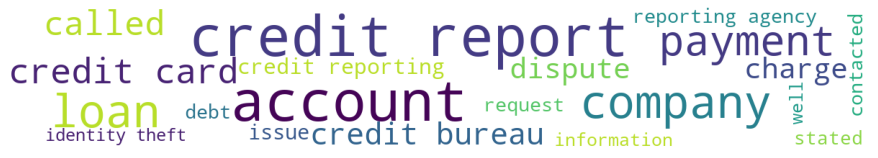



Cluster: 8 / 27


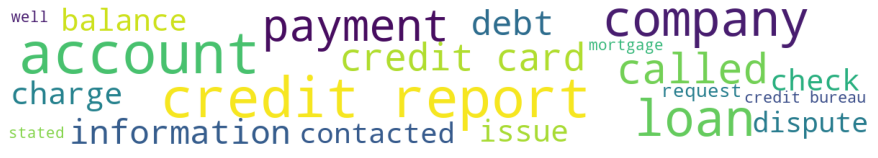



Cluster: 9 / 27


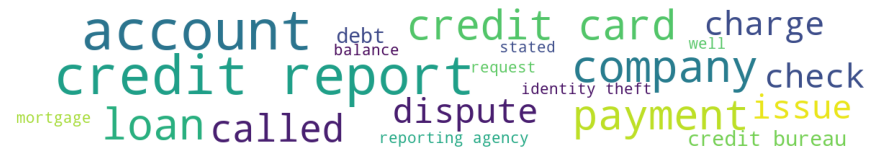



Cluster: 10 / 27


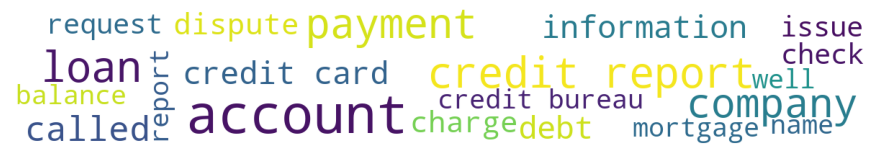



Cluster: 11 / 27


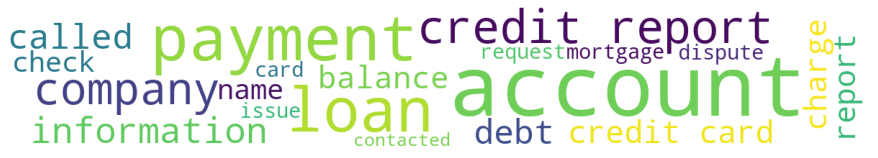



Cluster: 12 / 27


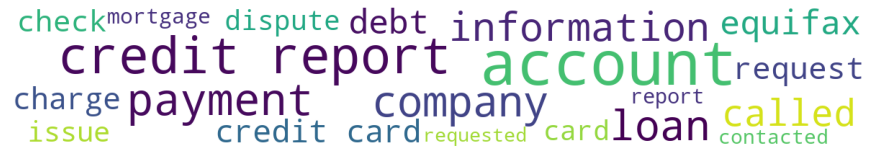



Cluster: 13 / 27


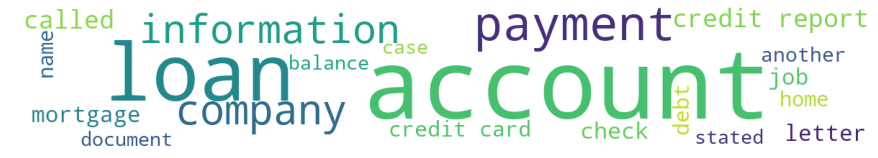



Cluster: 14 / 27


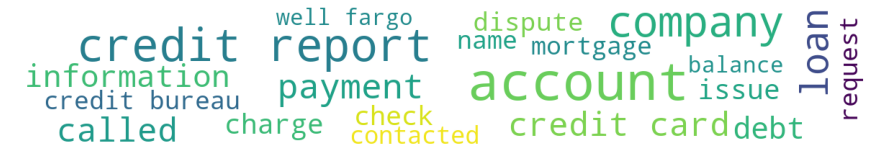



Cluster: 15 / 27


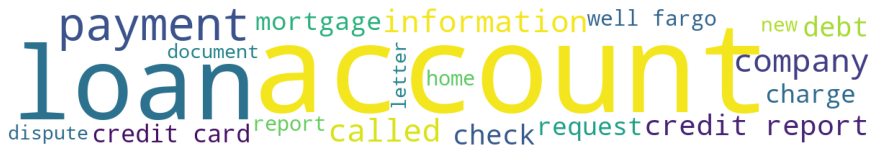



Cluster: 16 / 27


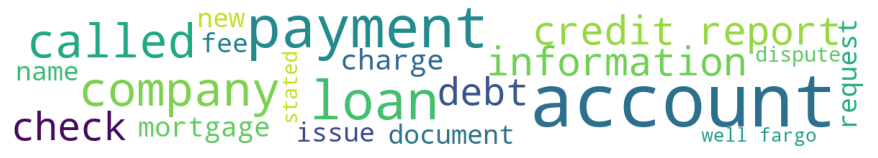



Cluster: 17 / 27


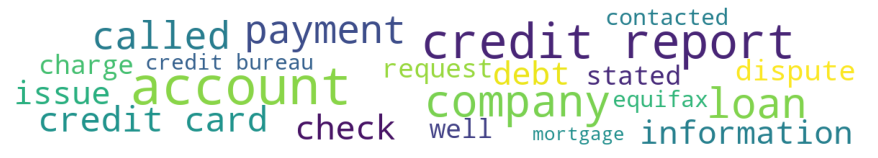



Cluster: 18 / 27


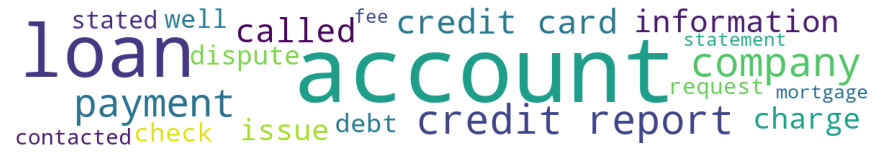



Cluster: 19 / 27


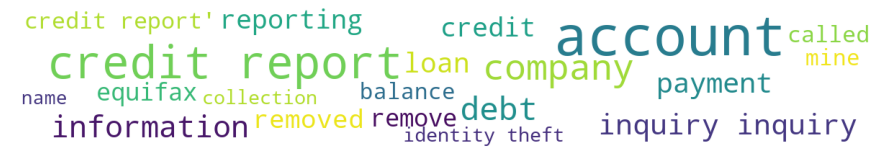



Cluster: 20 / 27


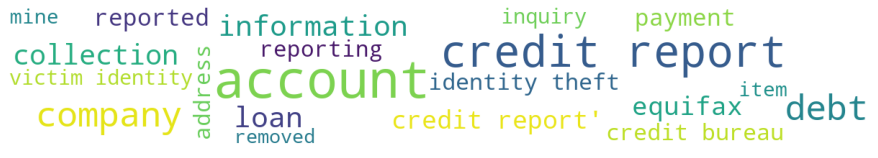



Cluster: 21 / 27


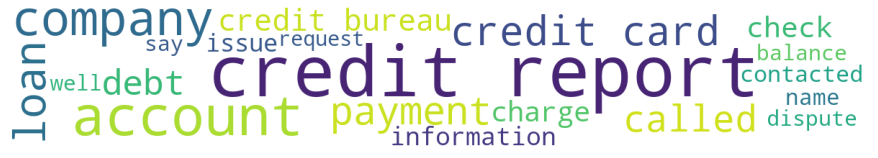



Cluster: 22 / 27


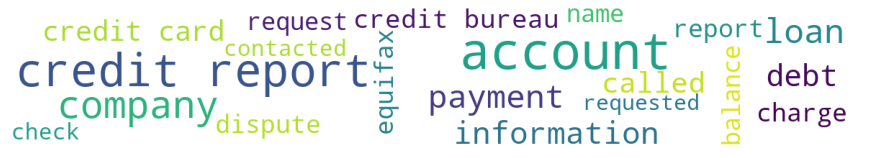



Cluster: 23 / 27


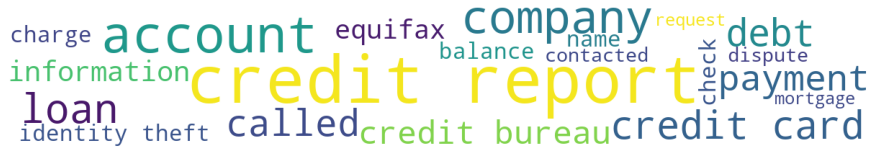



Cluster: 24 / 27


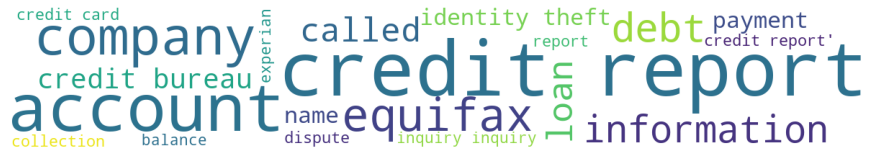



Cluster: 25 / 27


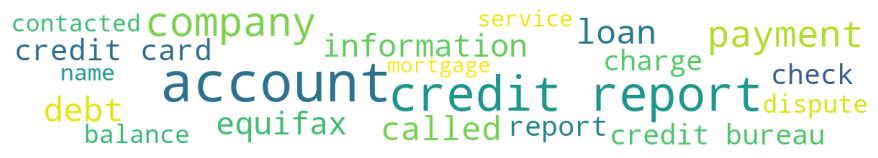



Cluster: 26 / 27


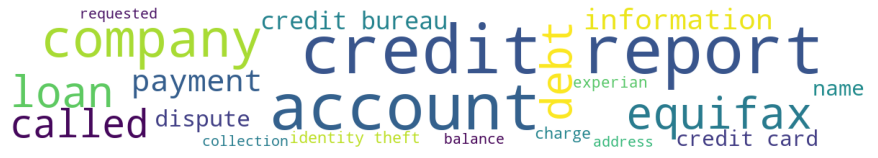



Cluster: 27 / 27


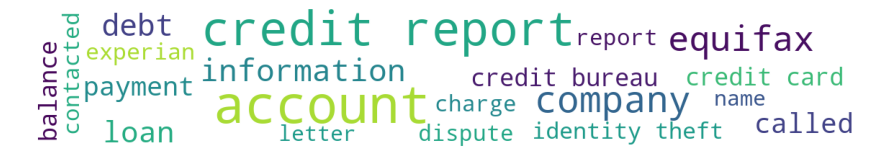




Cluster size of 21 
Cluster: 1 / 21


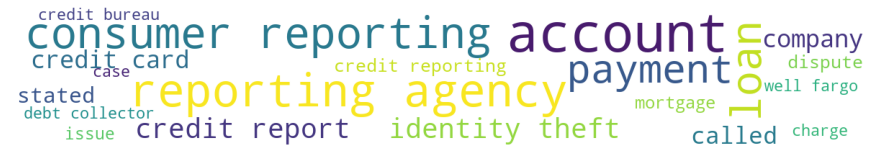



Cluster: 2 / 21


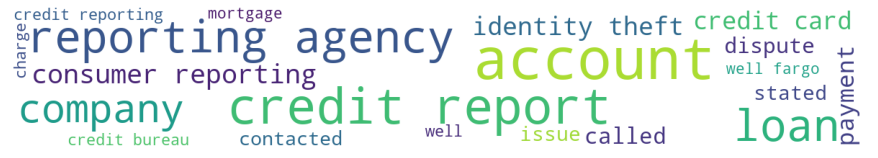



Cluster: 3 / 21


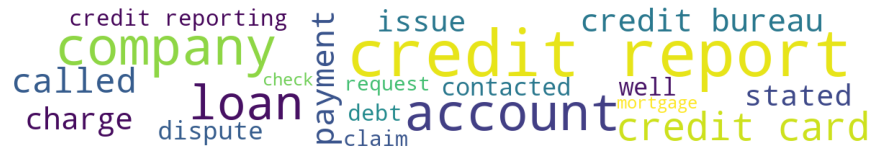



Cluster: 4 / 21


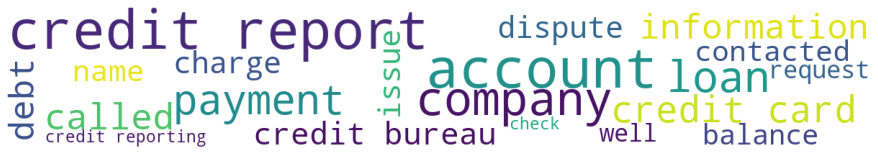



Cluster: 5 / 21


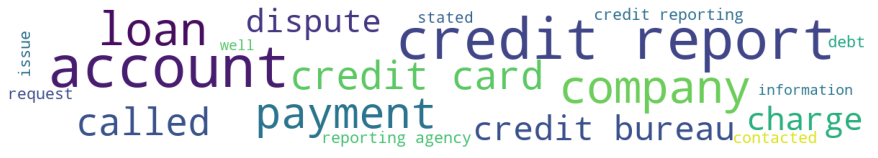



Cluster: 6 / 21


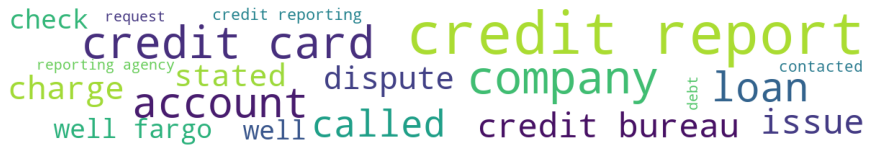



Cluster: 7 / 21


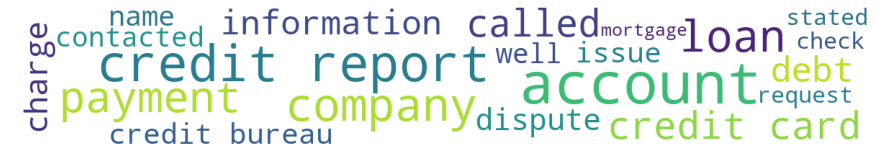



Cluster: 8 / 21


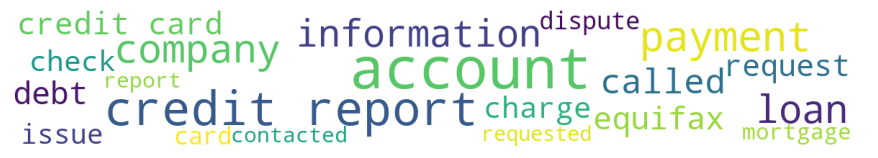



Cluster: 9 / 21


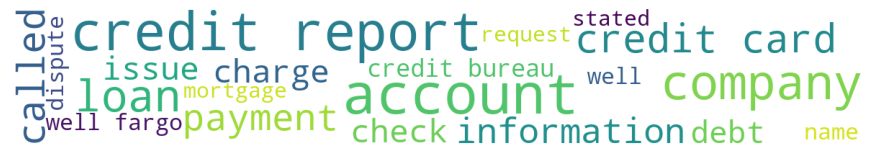



Cluster: 10 / 21


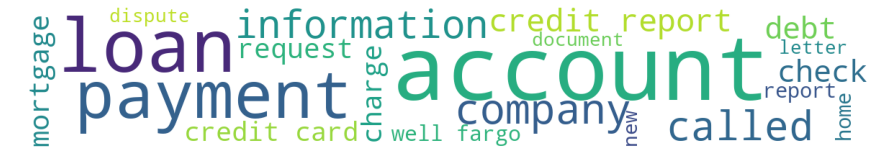



Cluster: 11 / 21


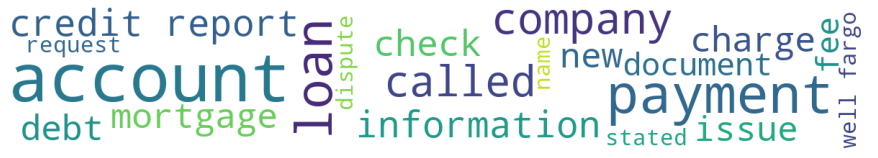



Cluster: 12 / 21


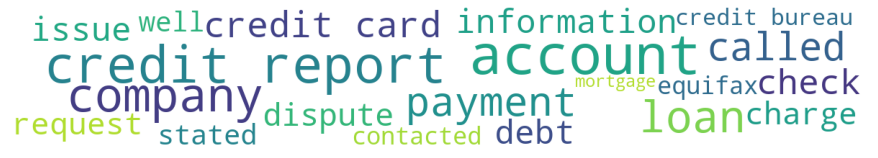



Cluster: 13 / 21


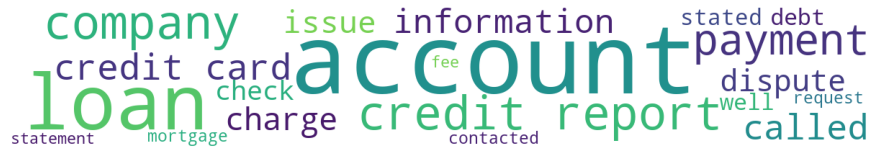



Cluster: 14 / 21


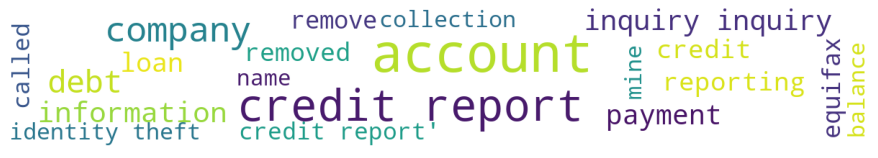



Cluster: 15 / 21


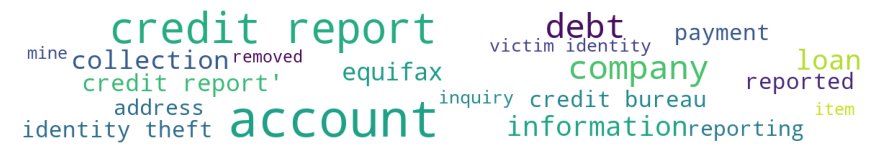



Cluster: 16 / 21


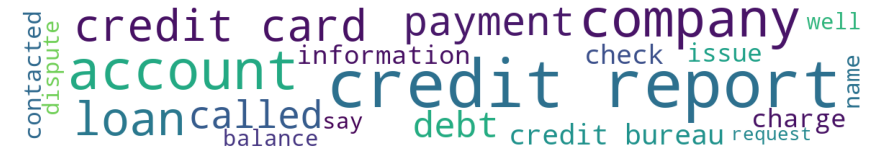



Cluster: 17 / 21


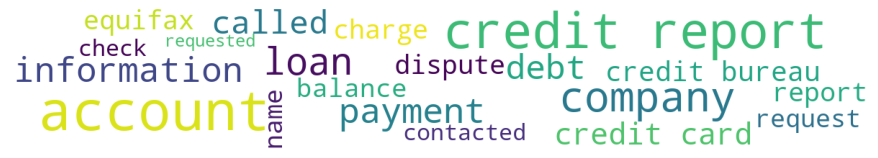



Cluster: 18 / 21


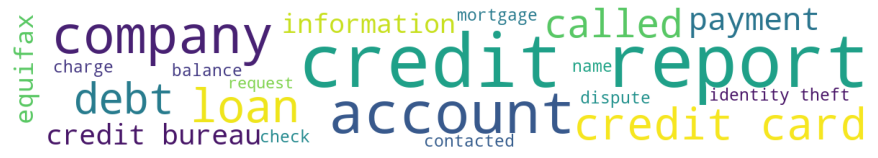



Cluster: 19 / 21


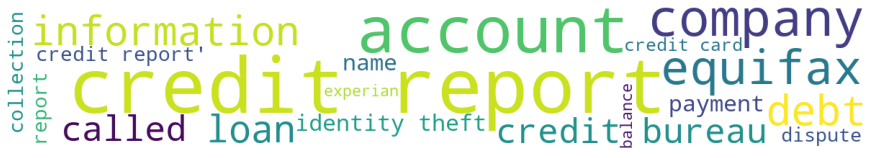



Cluster: 20 / 21


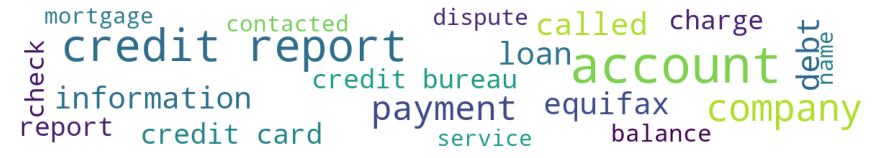



Cluster: 21 / 21


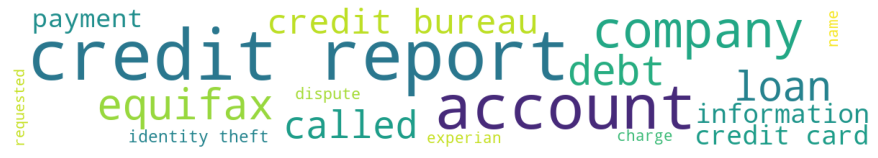




Cluster size of 20 
Cluster: 1 / 20


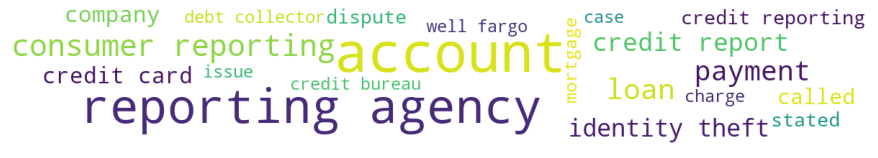



Cluster: 2 / 20


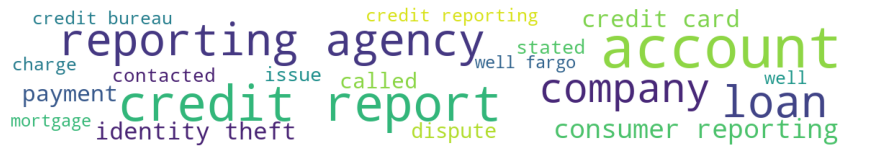



Cluster: 3 / 20


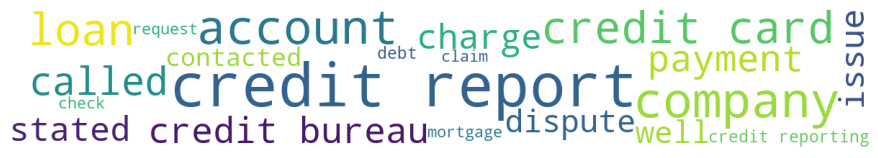



Cluster: 4 / 20


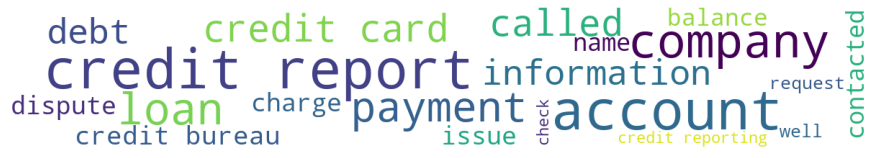



Cluster: 5 / 20


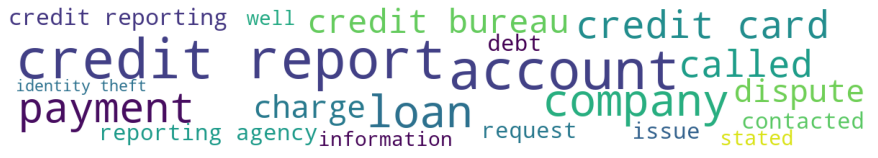



Cluster: 6 / 20


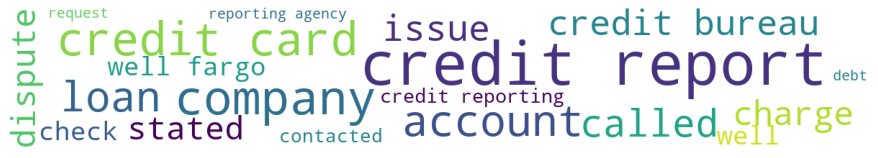



Cluster: 7 / 20


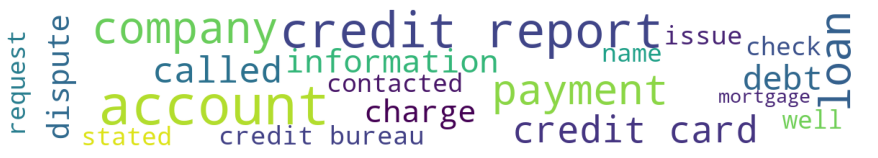



Cluster: 8 / 20


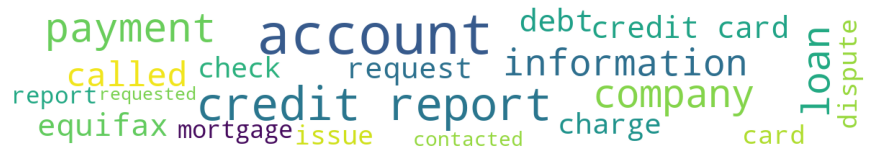



Cluster: 9 / 20


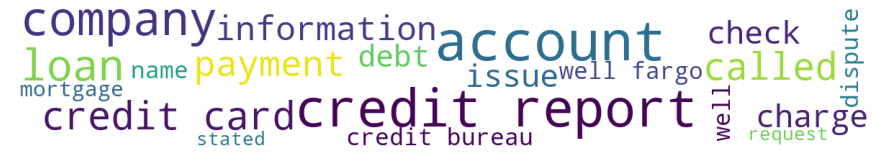



Cluster: 10 / 20


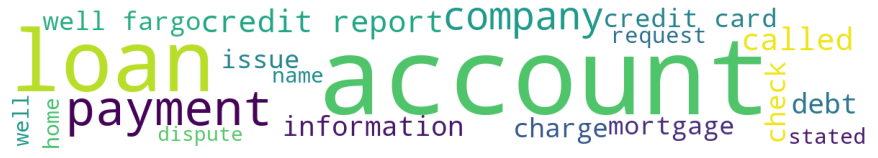



Cluster: 11 / 20


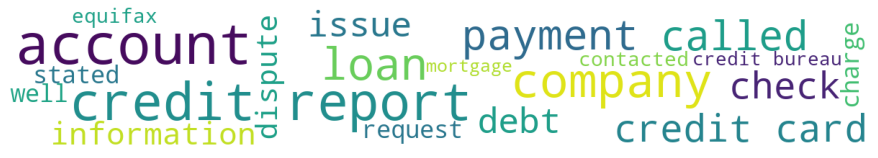



Cluster: 12 / 20


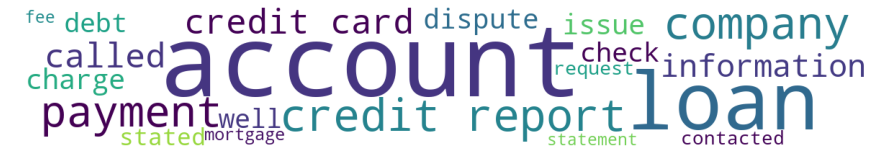



Cluster: 13 / 20


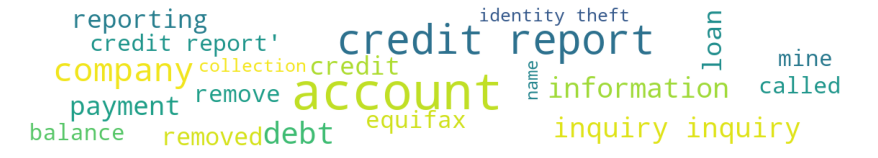



Cluster: 14 / 20


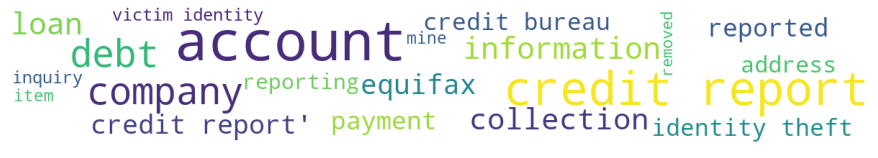



Cluster: 15 / 20


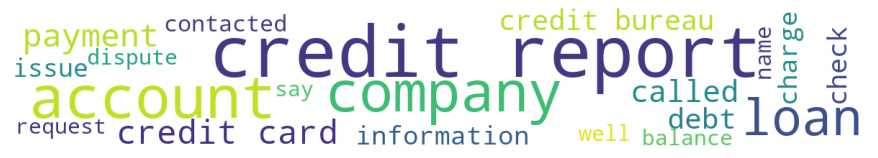



Cluster: 16 / 20


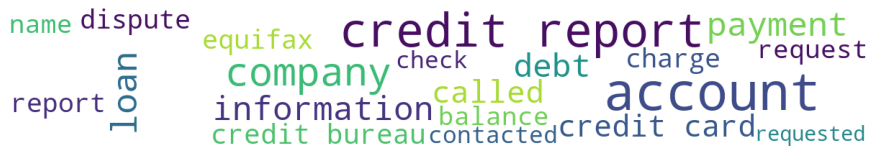



Cluster: 17 / 20


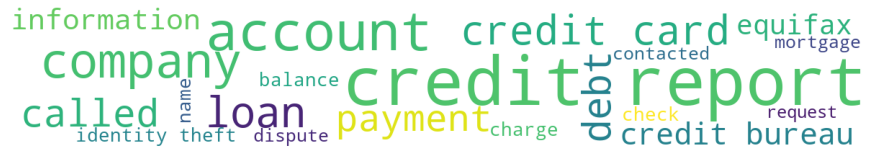



Cluster: 18 / 20


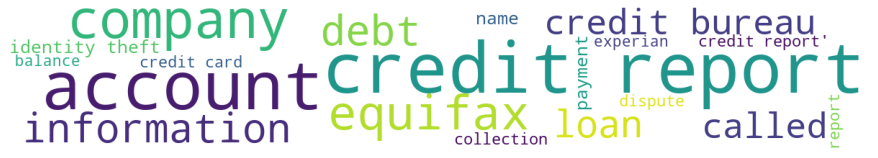



Cluster: 19 / 20


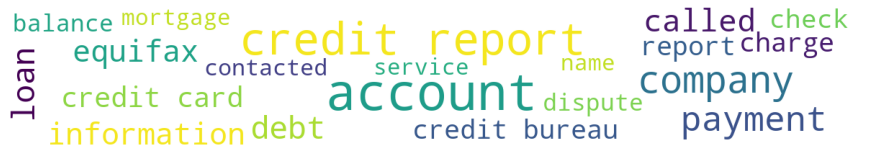



Cluster: 20 / 20


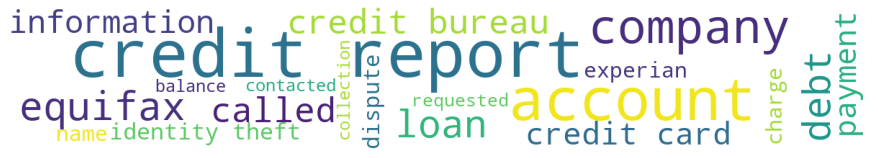




Cluster size of 19 
Cluster: 1 / 19


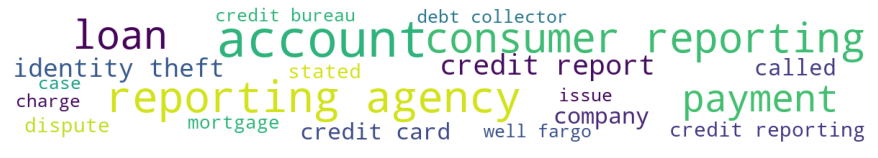



Cluster: 2 / 19


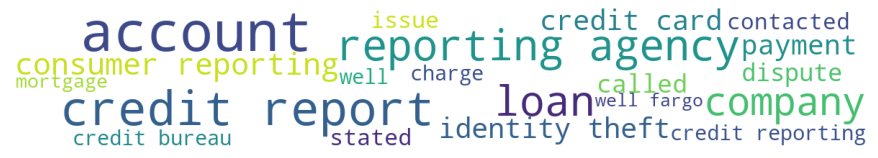



Cluster: 3 / 19


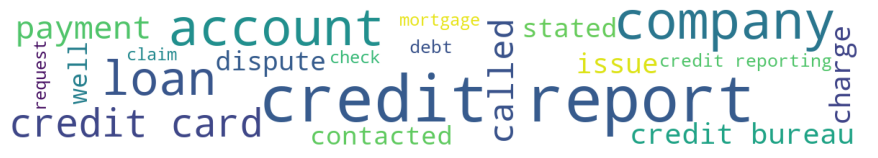



Cluster: 4 / 19


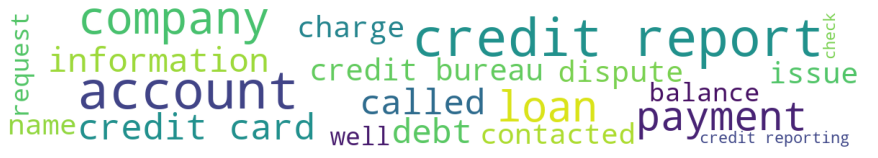



Cluster: 5 / 19


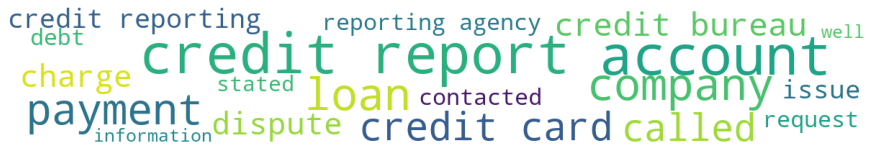



Cluster: 6 / 19


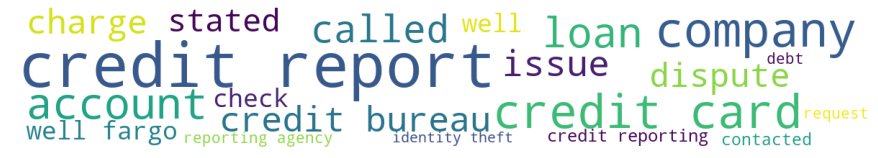



Cluster: 7 / 19


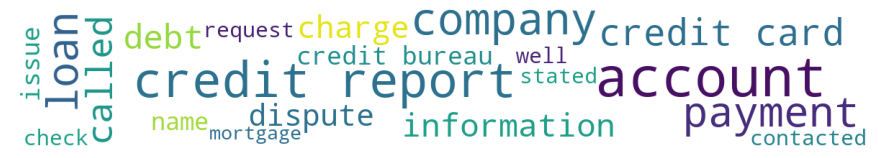



Cluster: 8 / 19


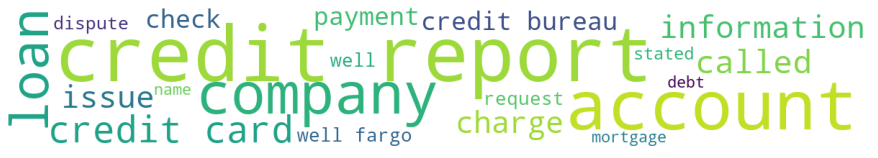



Cluster: 9 / 19


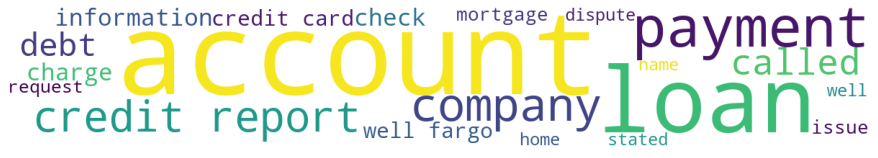



Cluster: 10 / 19


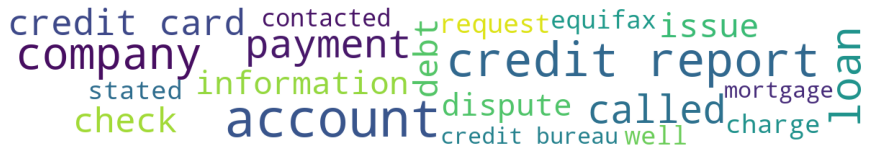



Cluster: 11 / 19


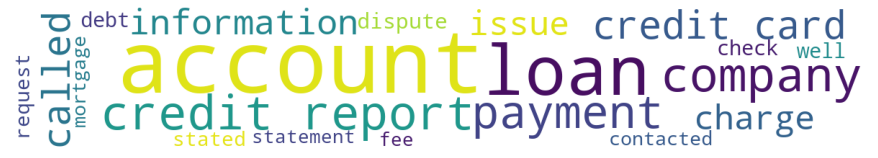



Cluster: 12 / 19


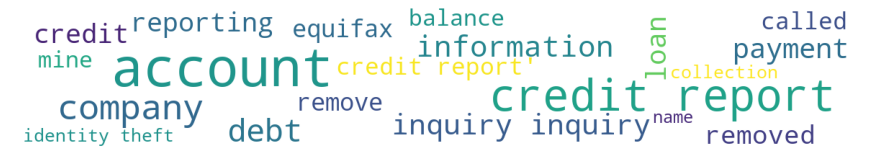



Cluster: 13 / 19


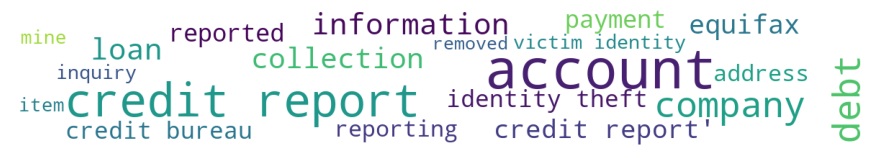



Cluster: 14 / 19


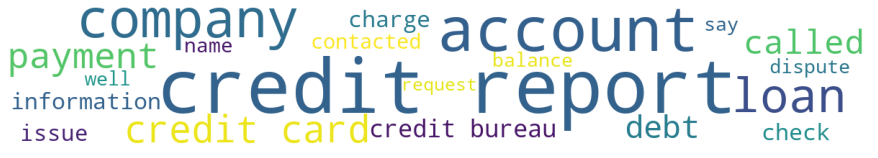



Cluster: 15 / 19


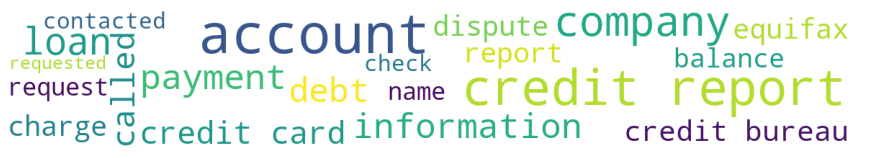



Cluster: 16 / 19


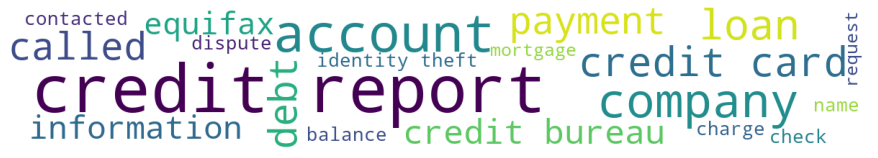



Cluster: 17 / 19


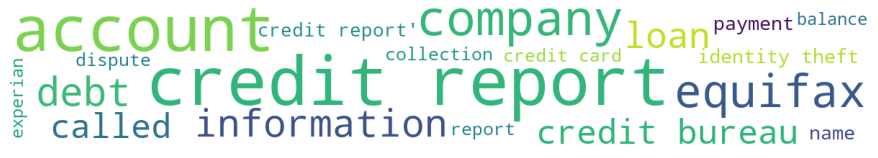



Cluster: 18 / 19


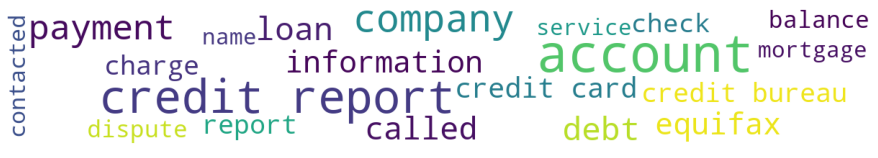



Cluster: 19 / 19


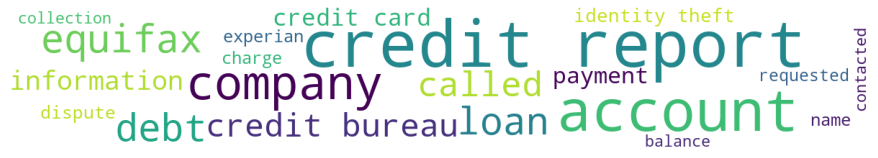




Cluster size of 18 
Cluster: 1 / 18


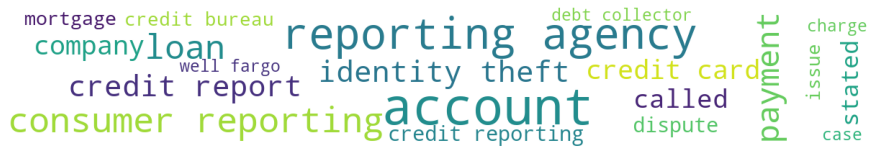



Cluster: 2 / 18


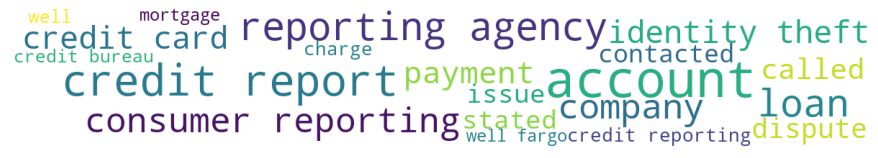



Cluster: 3 / 18


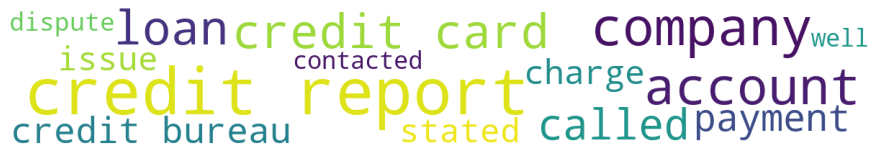



Cluster: 4 / 18


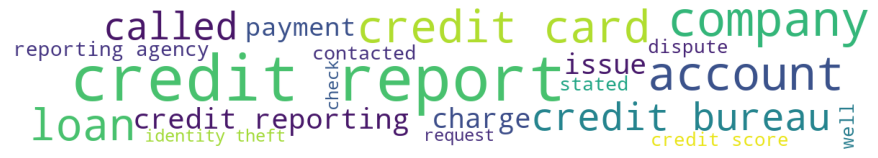



Cluster: 5 / 18


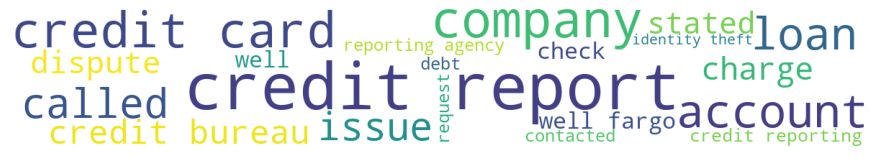



Cluster: 6 / 18


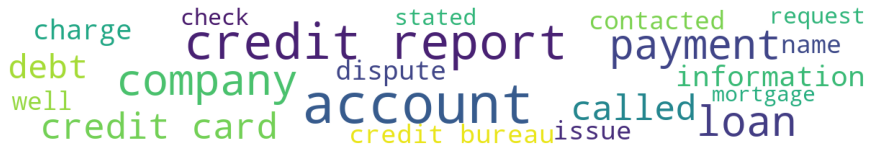



Cluster: 7 / 18


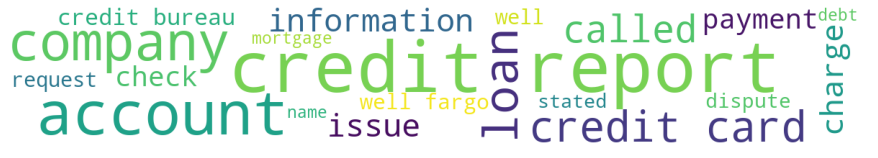



Cluster: 8 / 18


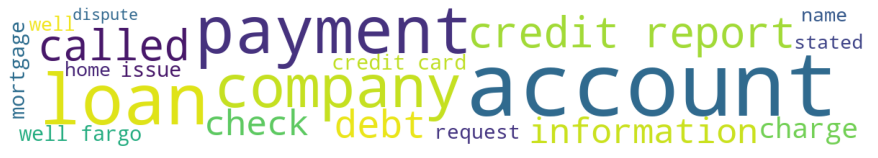



Cluster: 9 / 18


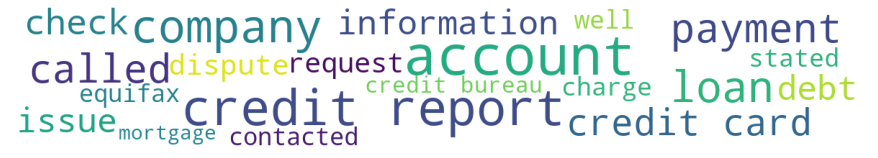



Cluster: 10 / 18


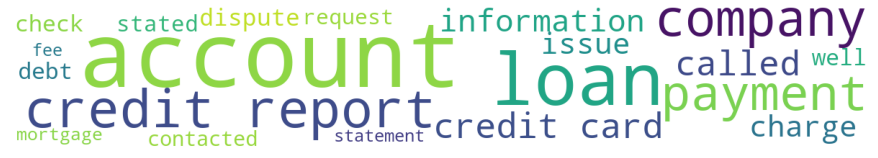



Cluster: 11 / 18


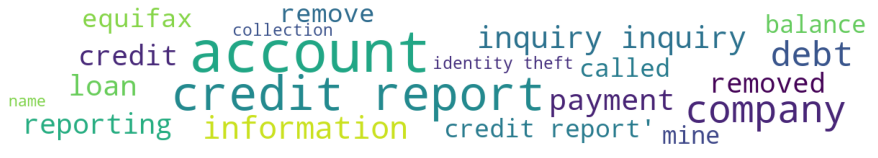



Cluster: 12 / 18


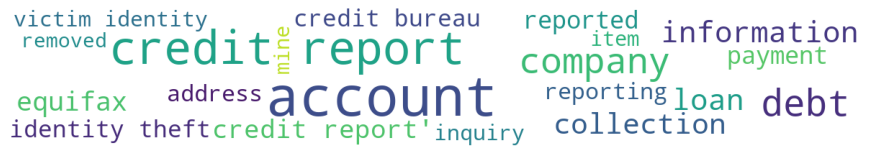



Cluster: 13 / 18


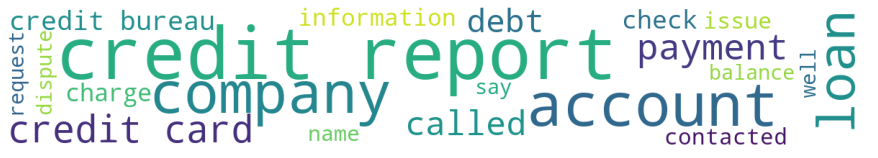



Cluster: 14 / 18


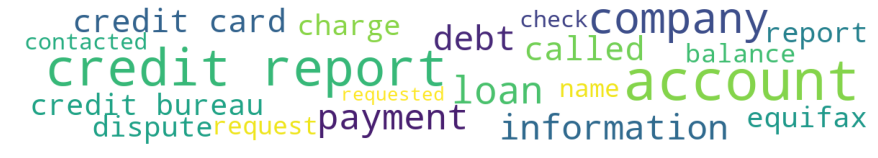



Cluster: 15 / 18


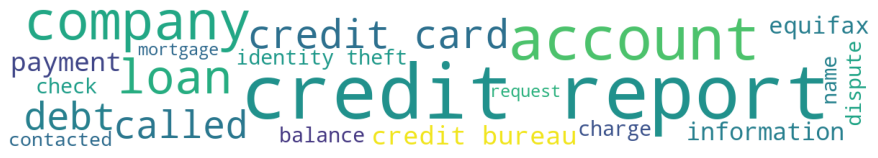



Cluster: 16 / 18


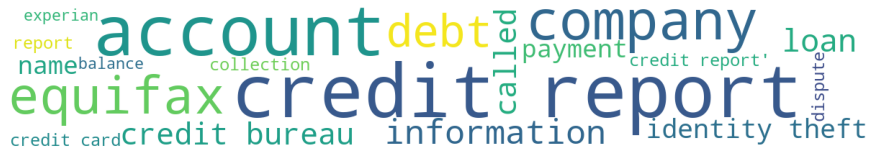



Cluster: 17 / 18


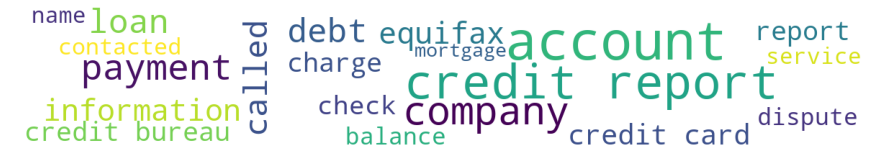



Cluster: 18 / 18


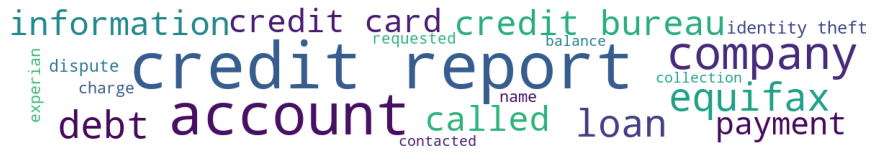




Cluster size of 16 
Cluster: 1 / 16


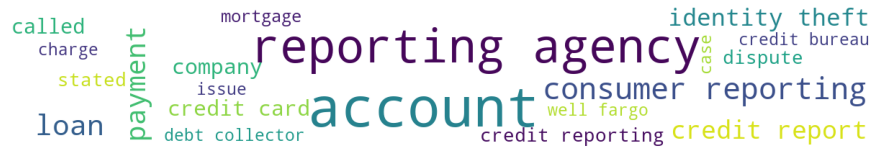



Cluster: 2 / 16


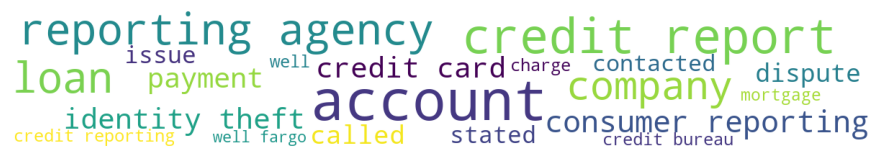



Cluster: 3 / 16


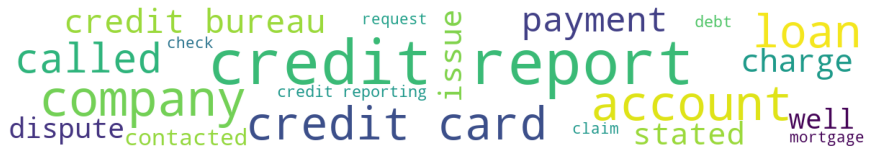



Cluster: 4 / 16


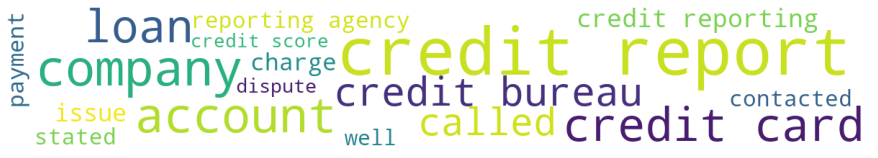



Cluster: 5 / 16


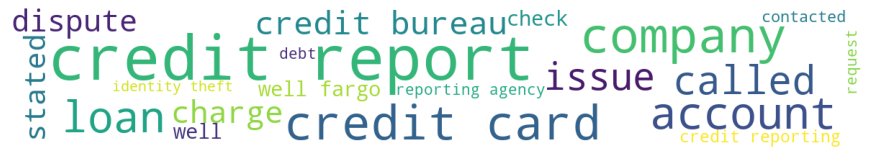



Cluster: 6 / 16


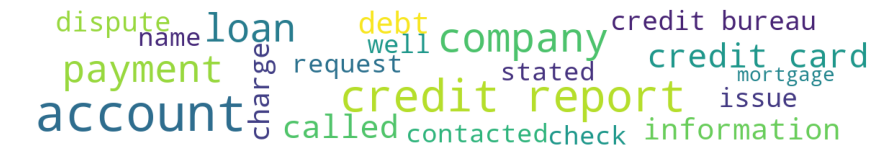



Cluster: 7 / 16


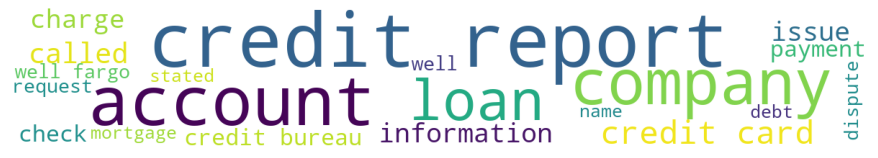



Cluster: 8 / 16


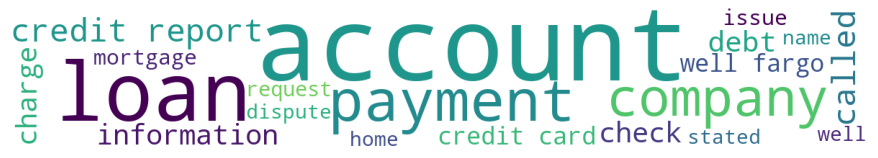



Cluster: 9 / 16


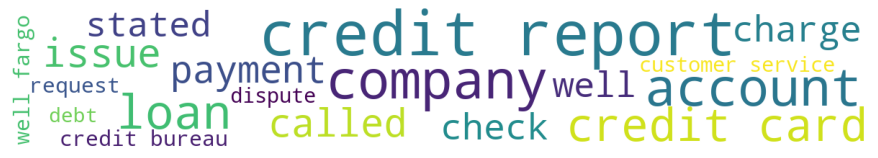



Cluster: 10 / 16


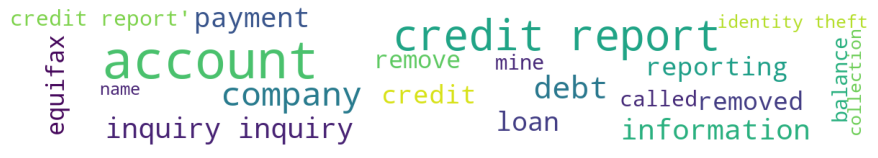



Cluster: 11 / 16


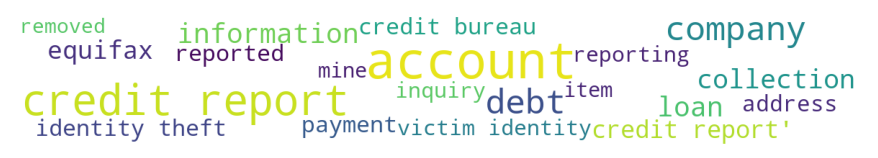



Cluster: 12 / 16


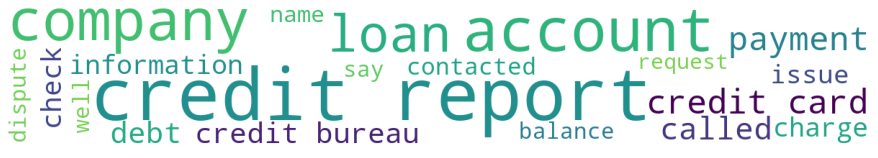



Cluster: 13 / 16


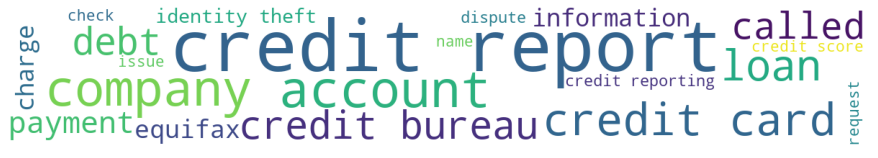



Cluster: 14 / 16


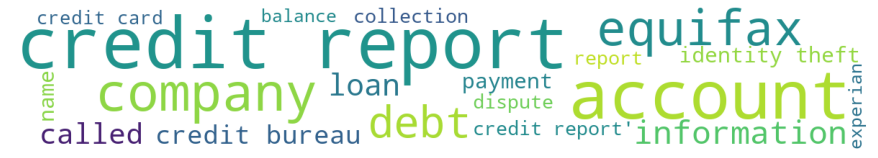



Cluster: 15 / 16


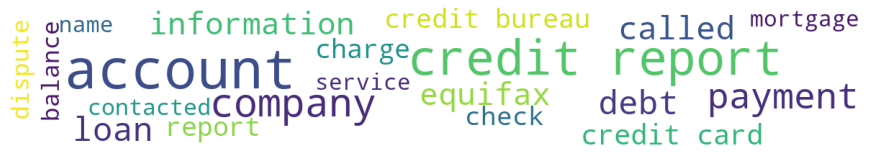



Cluster: 16 / 16


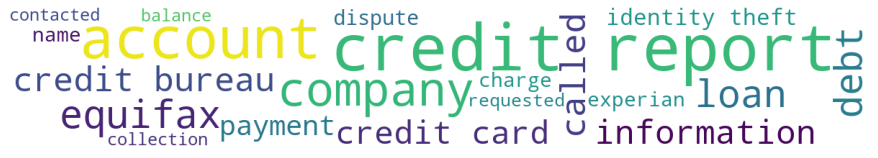




Cluster size of 15 
Cluster: 1 / 15


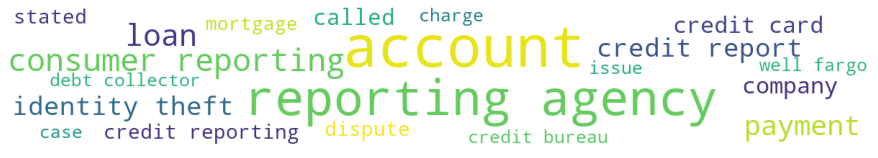



Cluster: 2 / 15


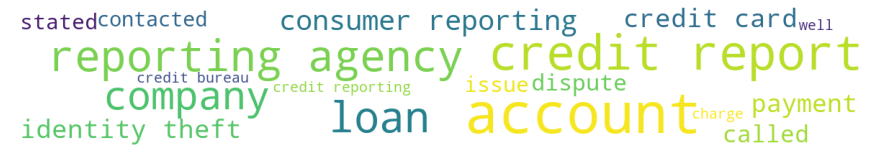



Cluster: 3 / 15


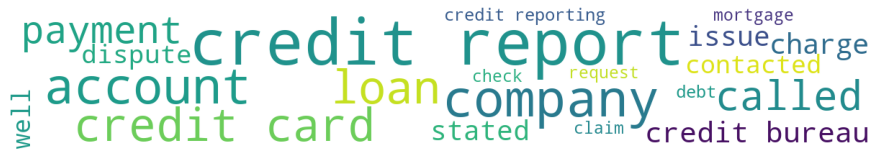



Cluster: 4 / 15


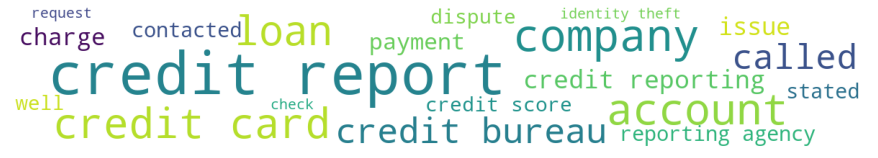



Cluster: 5 / 15


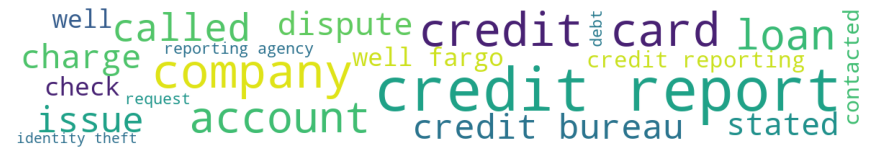



Cluster: 6 / 15


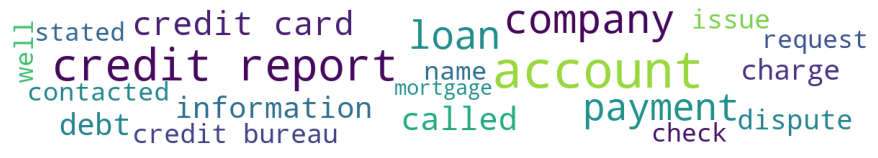



Cluster: 7 / 15


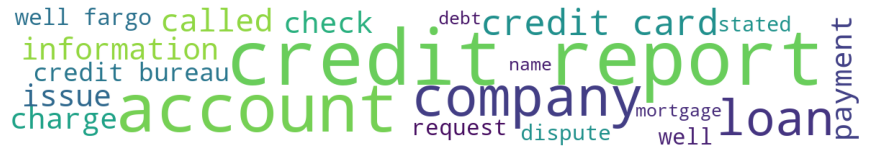



Cluster: 8 / 15


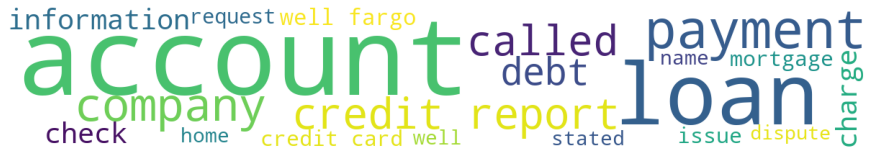



Cluster: 9 / 15


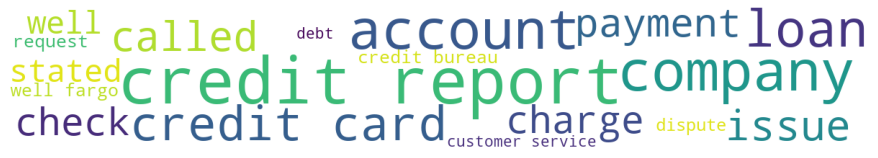



Cluster: 10 / 15


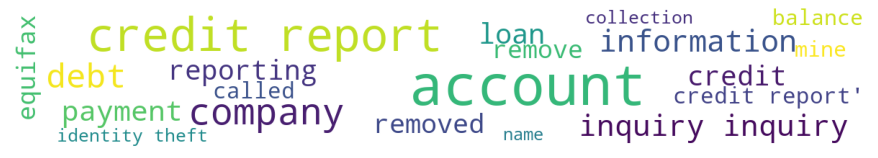



Cluster: 11 / 15


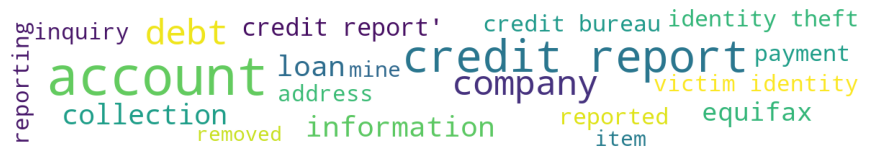



Cluster: 12 / 15


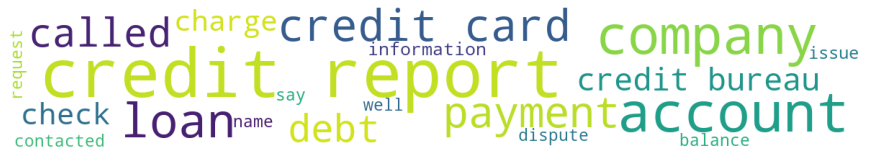



Cluster: 13 / 15


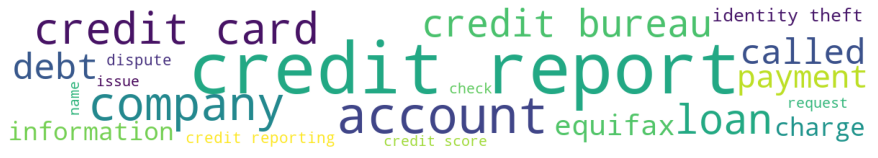



Cluster: 14 / 15


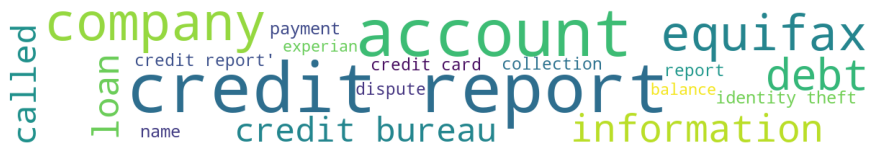



Cluster: 15 / 15


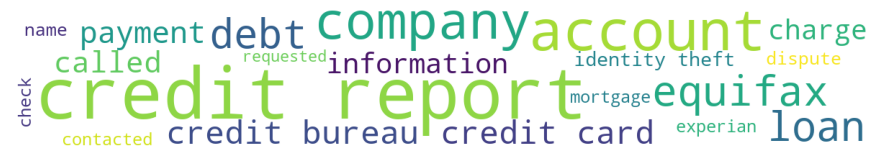




Cluster size of 13 
Cluster: 1 / 13


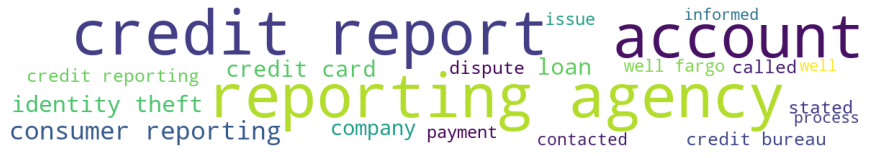



Cluster: 2 / 13


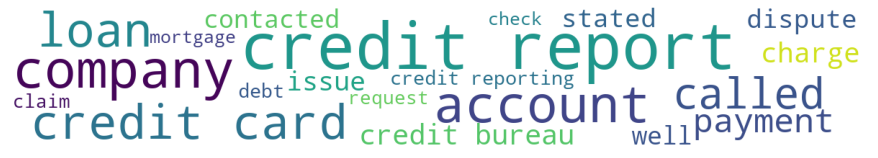



Cluster: 3 / 13


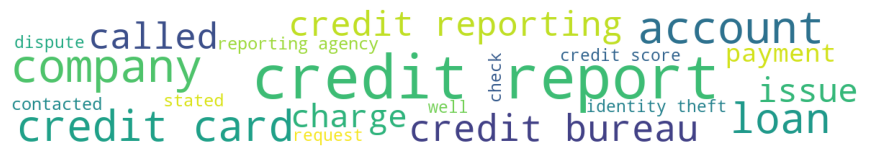



Cluster: 4 / 13


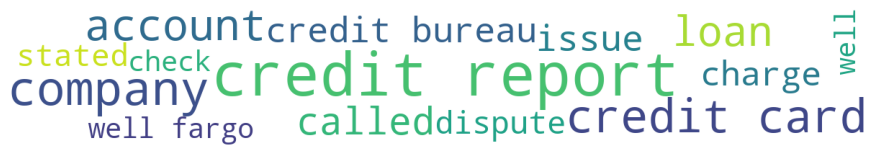



Cluster: 5 / 13


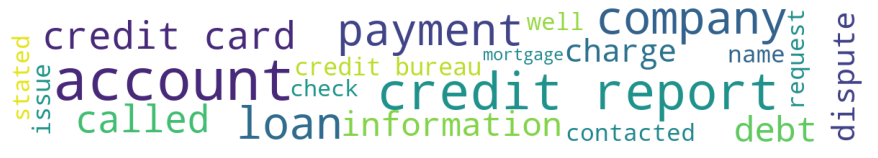



Cluster: 6 / 13


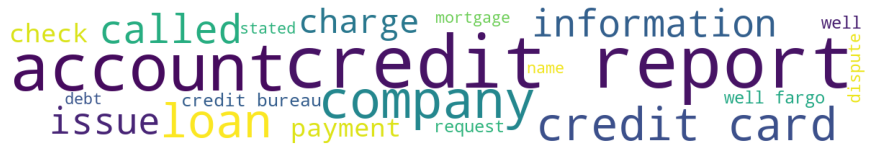



Cluster: 7 / 13


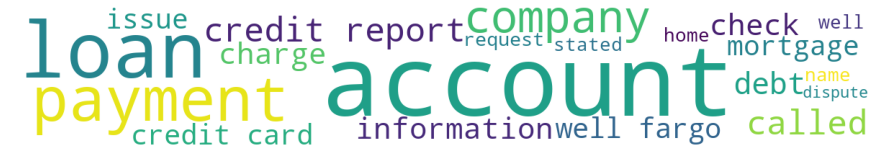



Cluster: 8 / 13


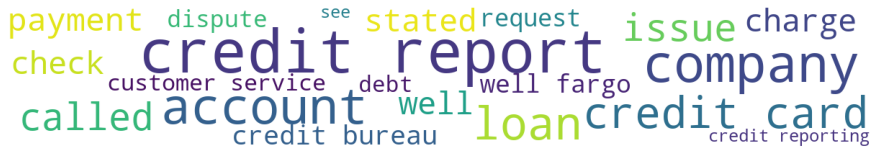



Cluster: 9 / 13


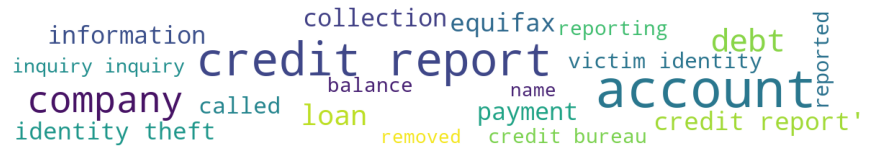



Cluster: 10 / 13


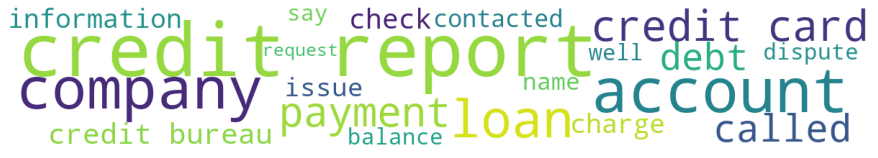



Cluster: 11 / 13


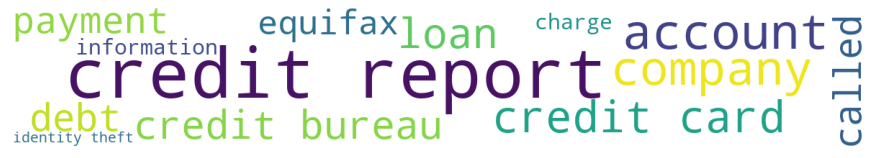



Cluster: 12 / 13


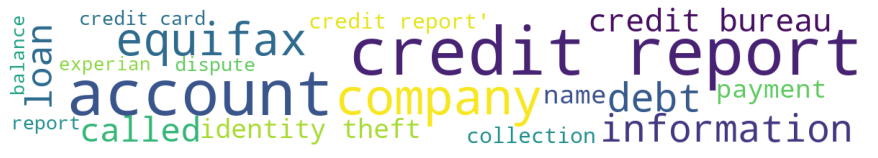



Cluster: 13 / 13


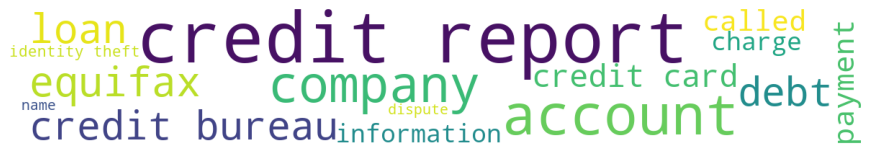




Cluster size of 12 
Cluster: 1 / 12


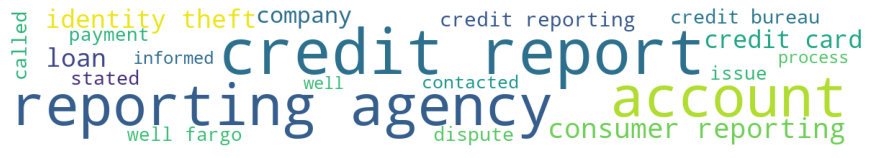



Cluster: 2 / 12


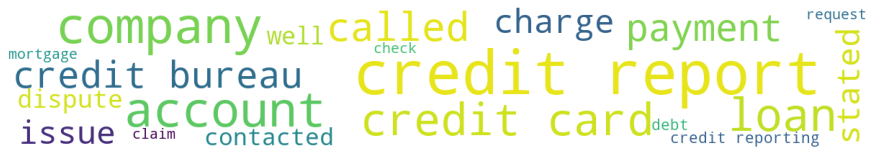



Cluster: 3 / 12


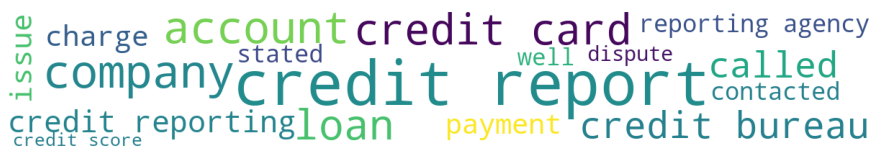



Cluster: 4 / 12


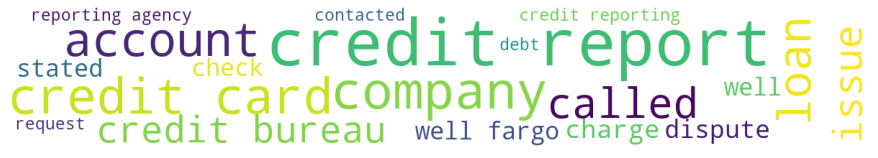



Cluster: 5 / 12


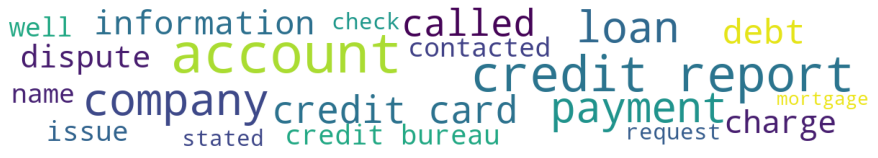



Cluster: 6 / 12


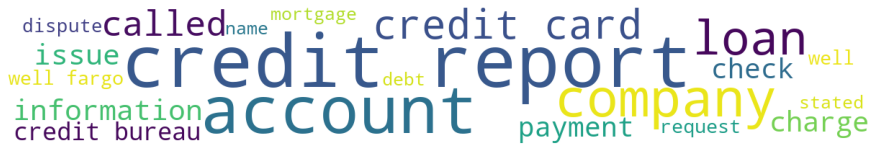



Cluster: 7 / 12


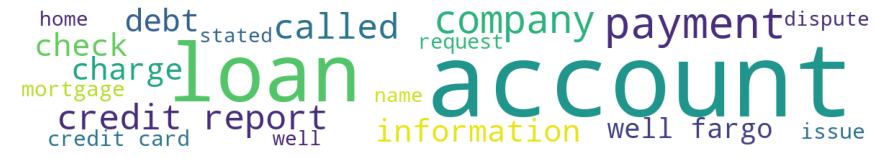



Cluster: 8 / 12


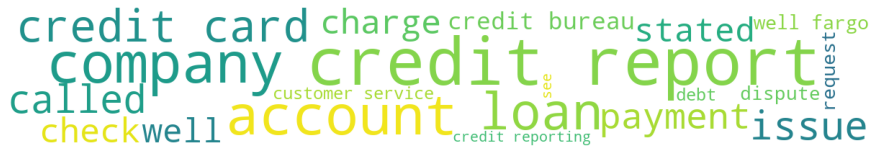



Cluster: 9 / 12


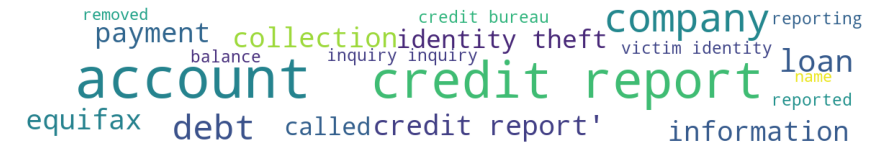



Cluster: 10 / 12


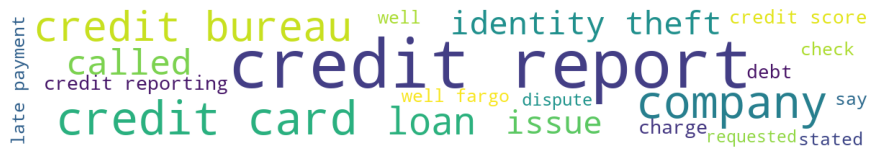



Cluster: 11 / 12


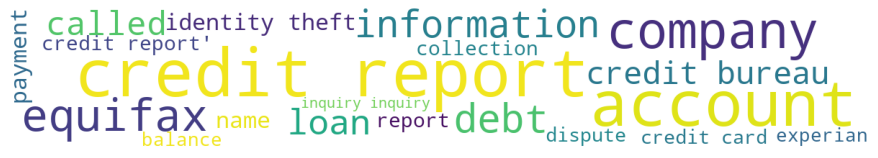



Cluster: 12 / 12


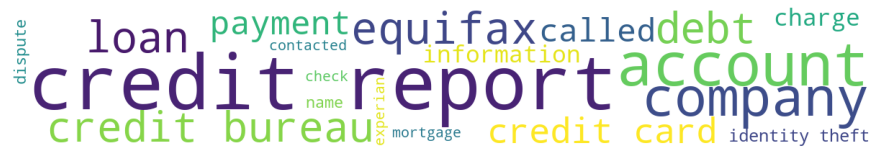




Cluster size of 11 
Cluster: 1 / 11


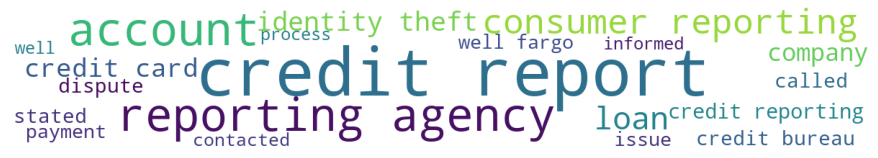



Cluster: 2 / 11


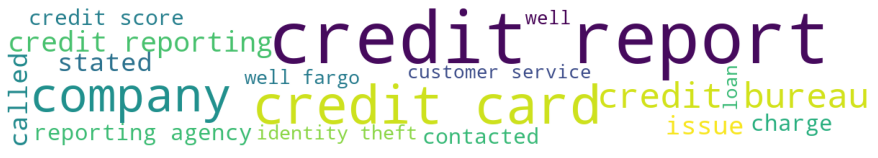



Cluster: 3 / 11


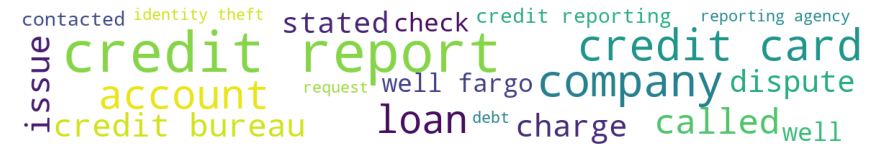



Cluster: 4 / 11


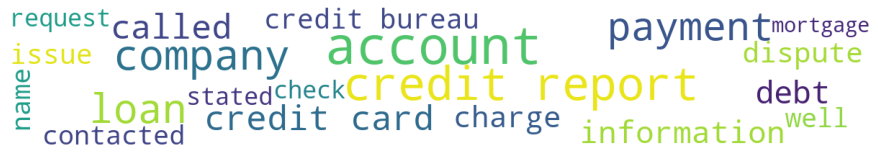



Cluster: 5 / 11


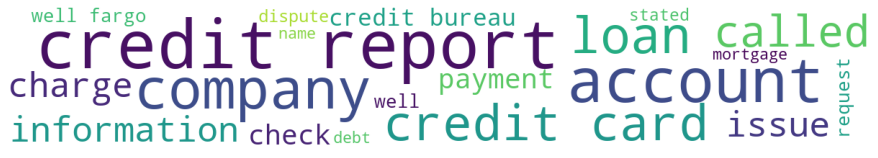



Cluster: 6 / 11


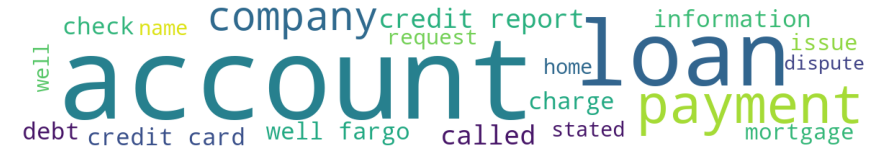



Cluster: 7 / 11


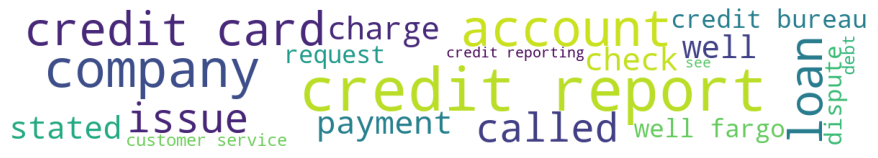



Cluster: 8 / 11


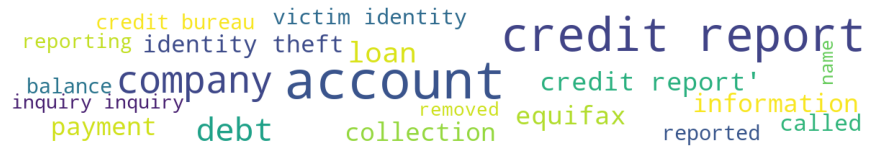



Cluster: 9 / 11


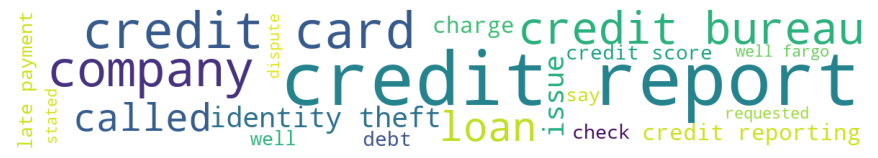



Cluster: 10 / 11


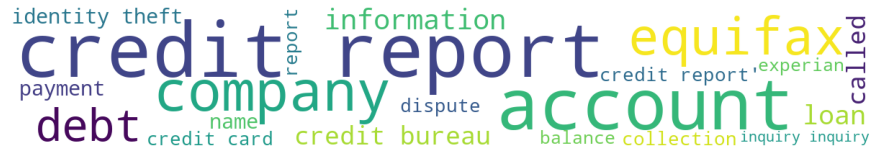



Cluster: 11 / 11


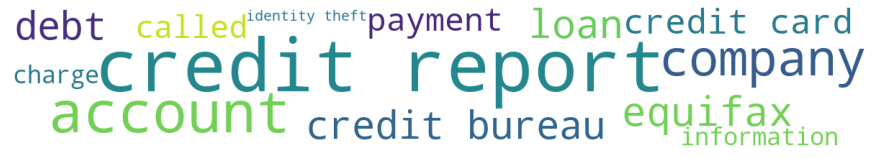




Cluster size of 10 
Cluster: 1 / 10


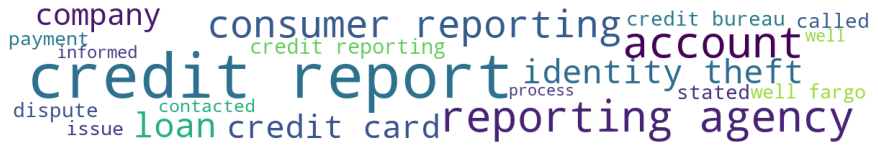



Cluster: 2 / 10


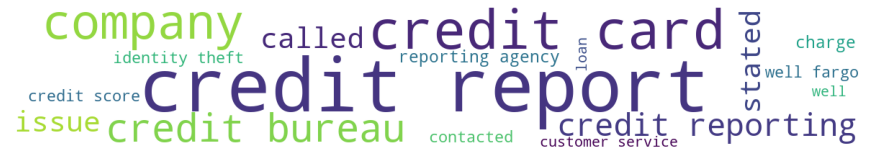



Cluster: 3 / 10


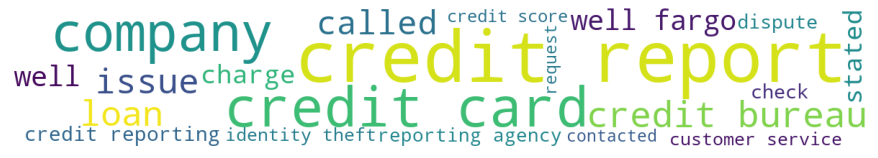



Cluster: 4 / 10


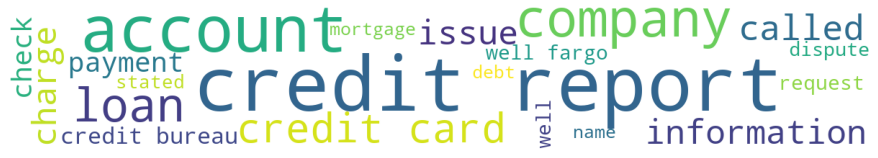



Cluster: 5 / 10


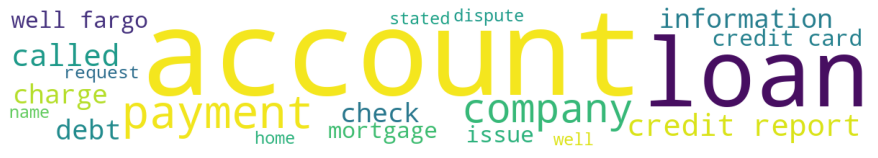



Cluster: 6 / 10


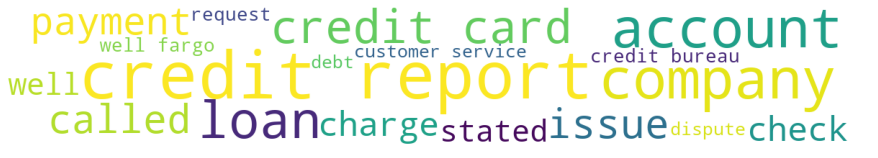



Cluster: 7 / 10


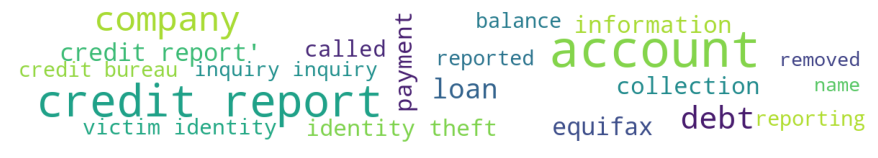



Cluster: 8 / 10


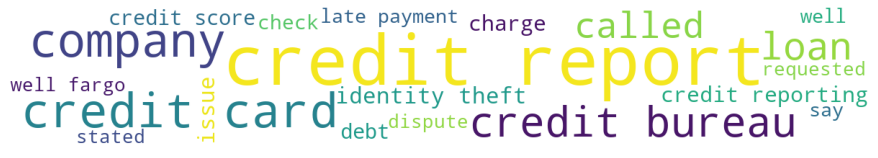



Cluster: 9 / 10


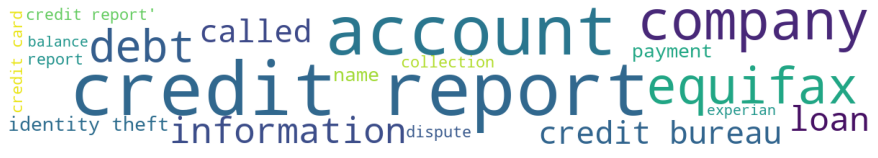



Cluster: 10 / 10


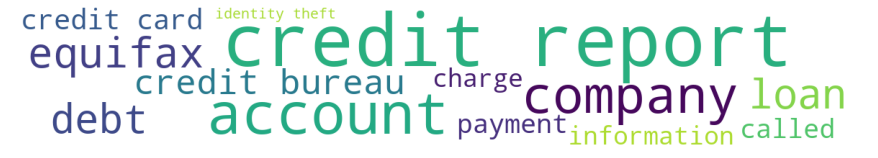




Cluster size of 9 
Cluster: 1 / 9


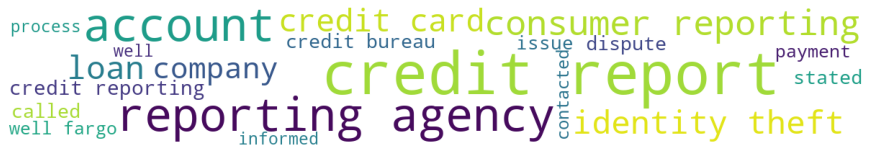



Cluster: 2 / 9


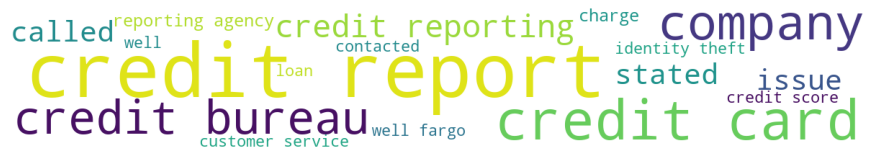



Cluster: 3 / 9


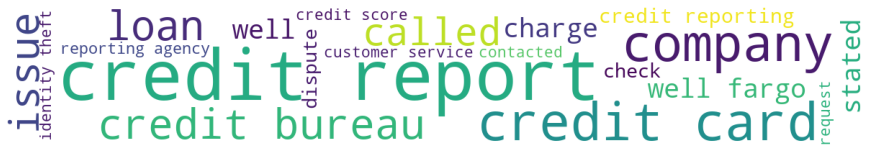



Cluster: 4 / 9


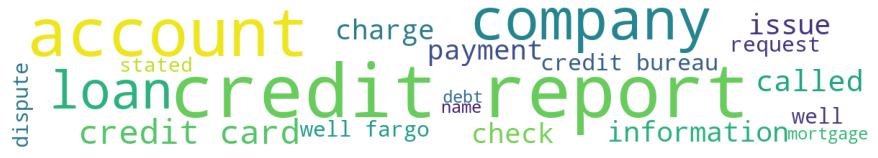



Cluster: 5 / 9


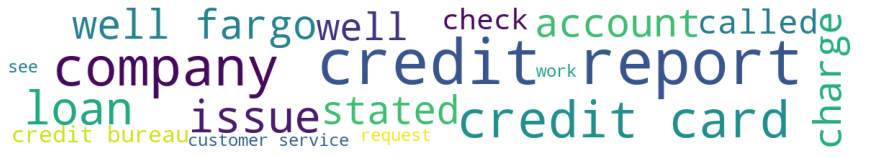



Cluster: 6 / 9


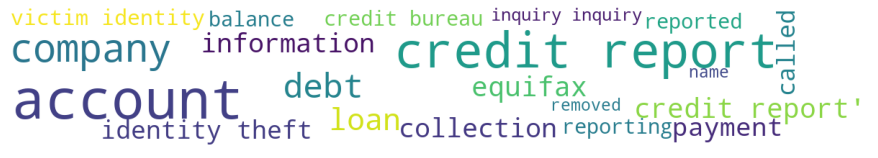



Cluster: 7 / 9


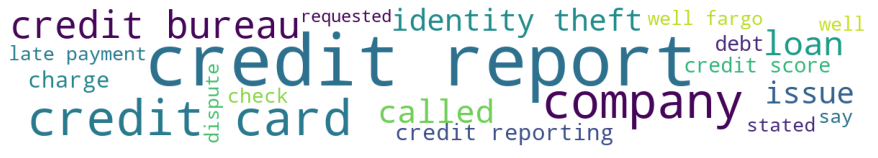



Cluster: 8 / 9


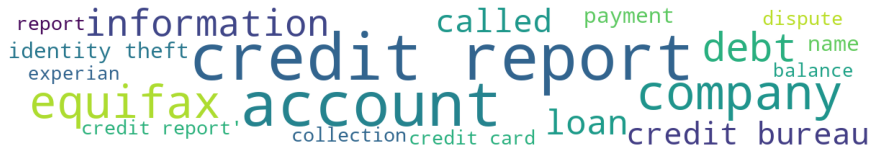



Cluster: 9 / 9


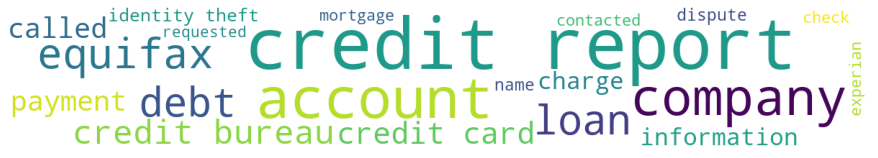




Cluster size of 8 
Cluster: 1 / 8


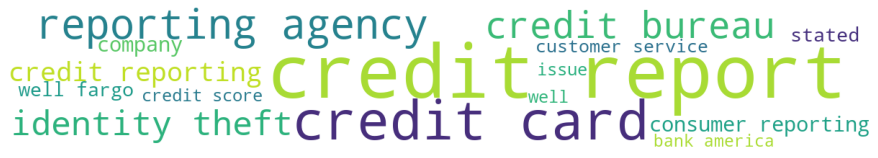



Cluster: 2 / 8


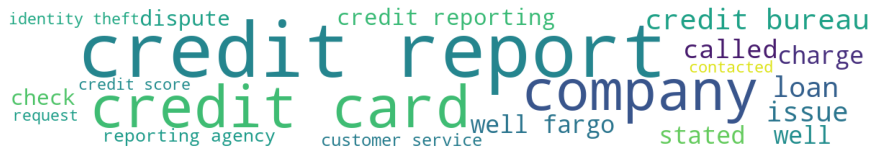



Cluster: 3 / 8


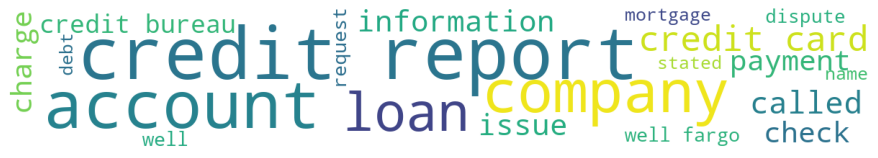



Cluster: 4 / 8


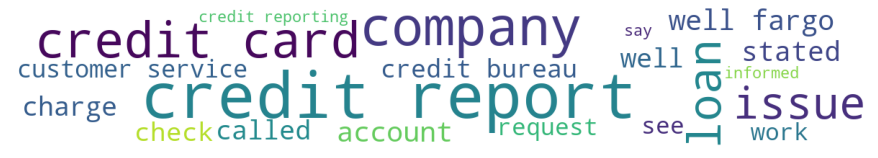



Cluster: 5 / 8


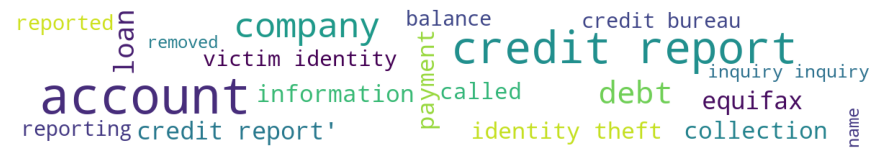



Cluster: 6 / 8


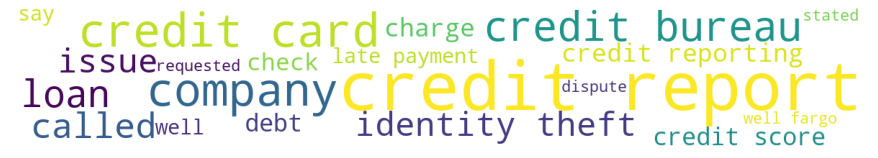



Cluster: 7 / 8


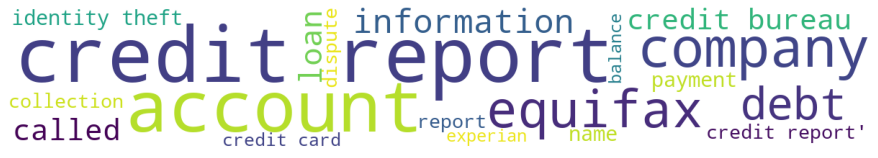



Cluster: 8 / 8


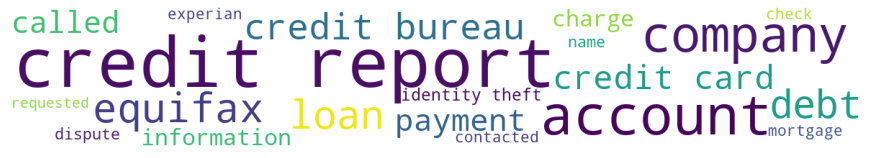




Cluster size of 7 
Cluster: 1 / 7


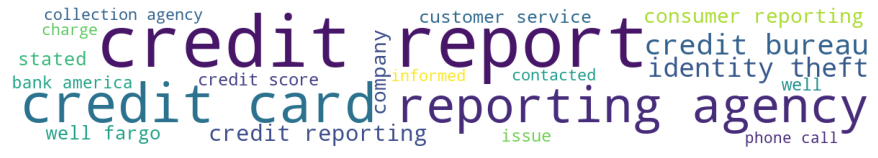



Cluster: 2 / 7


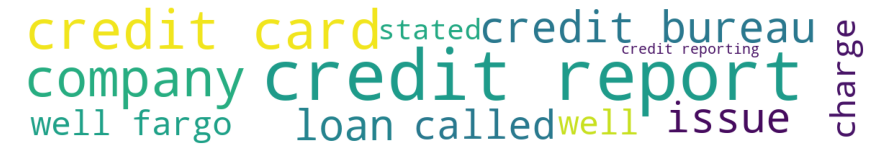



Cluster: 3 / 7


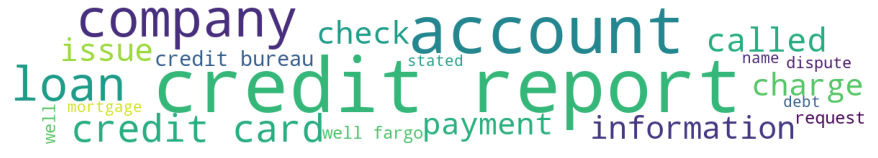



Cluster: 4 / 7


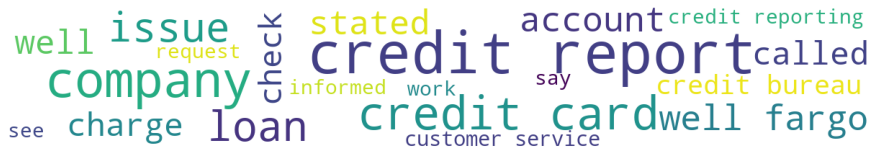



Cluster: 5 / 7


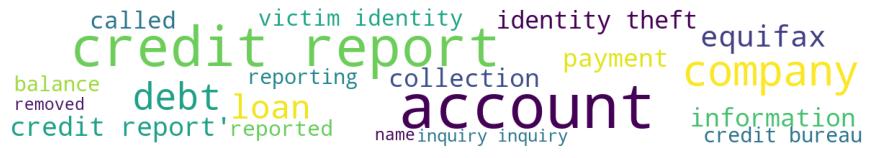



Cluster: 6 / 7


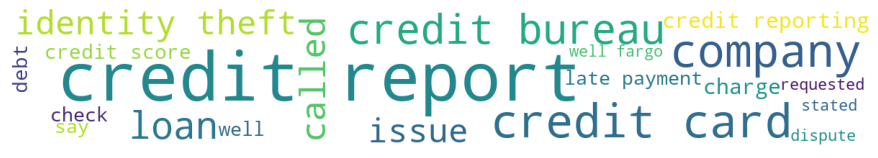



Cluster: 7 / 7


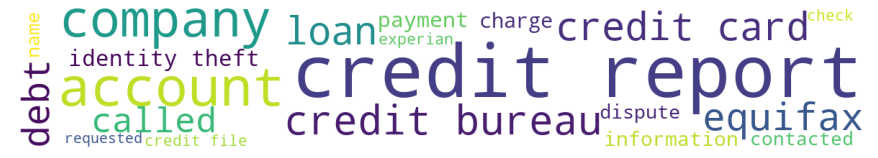




Cluster size of 6 
Cluster: 1 / 6


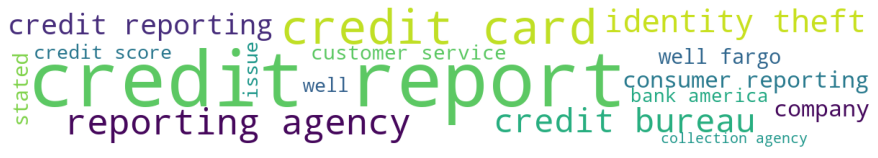



Cluster: 2 / 6


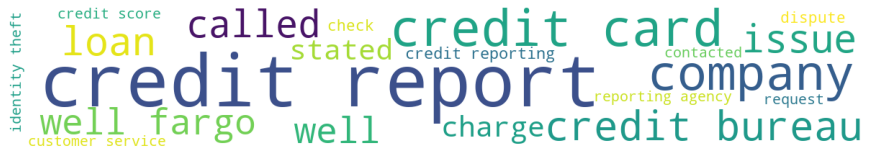



Cluster: 3 / 6


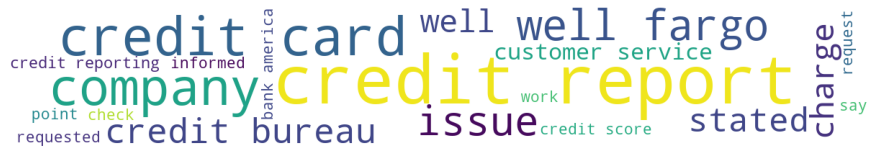



Cluster: 4 / 6


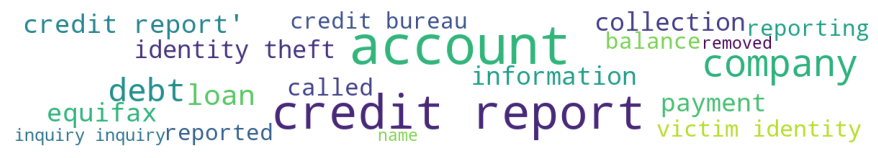



Cluster: 5 / 6


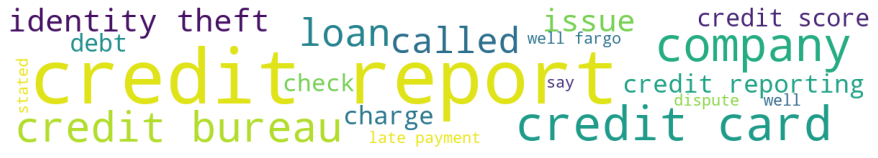



Cluster: 6 / 6


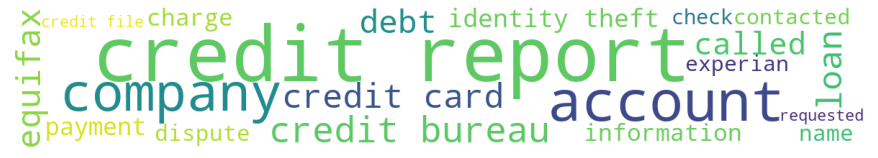




Cluster size of 5 
Cluster: 1 / 5


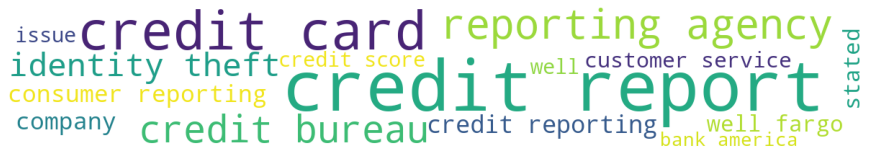



Cluster: 2 / 5


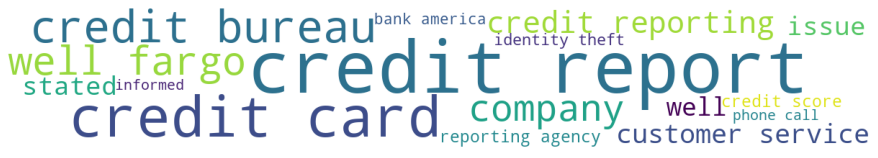



Cluster: 3 / 5


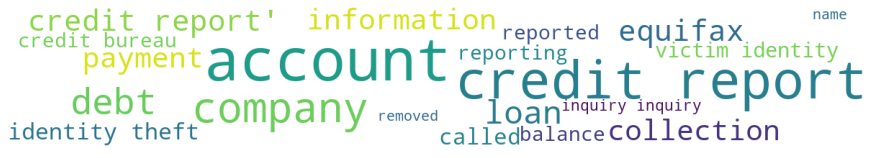



Cluster: 4 / 5


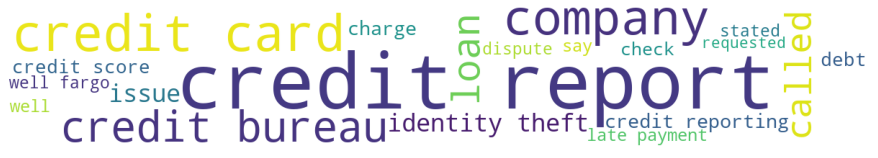



Cluster: 5 / 5


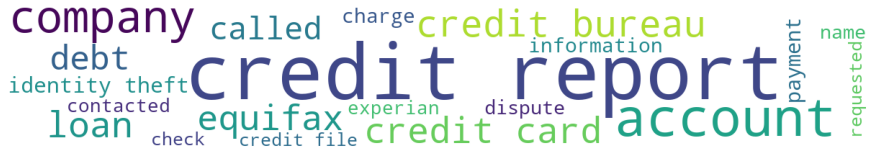

In [88]:
import collections
from wordcloud import WordCloud

stopwords = [
    'told', 'still', 'one', 'said', 'asked', 'sent', 'call', 'amount', 'received', 'would', 
    'could', 'day', 'since', 'never', 'also', 'time', 'back', 'year', 'get', 'even', 
    'paid', 'month', 'pay', 'money', 'bank', 'however', 'made', 'due', 'email', 'stated', 
    'name', 'date', 'want', 'need', 'first', 'know'
]

for cluster in doc_by_clusters:
    # cluster = dict where key = cluster and value = document
    print('\033[1m')
    print('Cluster size of', len(cluster), '\033[0m')
    print('==================')
    cluster = collections.OrderedDict(sorted(cluster.items()))
    
    for i in cluster.keys():
        print("Cluster:", i, "/", len(cluster))
        
        cluster_corpus = cleaned_dataset_excluding_outliers['Consumer complaint narrative'][cluster[i]].tolist()
        cluster_corpus = str(cluster_corpus)
        
        wordcloud = WordCloud(width = 1200, height = 200, max_words=20, stopwords=stopwords, background_color = 'white', min_font_size = 20).generate(cluster_corpus)
        
        plt.figure(figsize = (12, 2), facecolor = None)
        plt.imshow(wordcloud)
        plt.axis("off")
        plt.tight_layout(pad = 0)
        plt.show()
        
        print("\n")